<a href="https://colab.research.google.com/github/promedius/tutorial/blob/master/cyclegan_handson.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

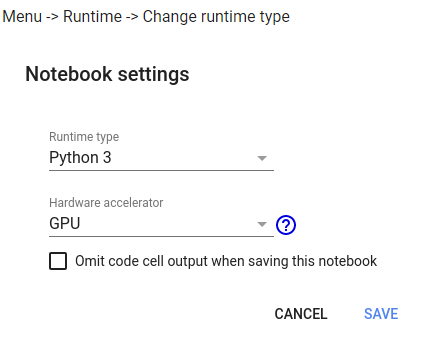

In [ ]:
#할당된 gpu 확인
!nvidia-smi

# 런타임 유형을 GPU로 설정하지 않으면 아래 문구가 뜸
#NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.

Sat Aug 14 05:28:23 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#현재 경로에 있는 파일이 무엇이 있는지 확인해보기(아래 코드를 받고 난 후와 비교)
!ls

sample_data


In [ ]:
!git clone https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

Cloning into 'pytorch-CycleGAN-and-pix2pix'...
remote: Enumerating objects: 2340, done.
remote: Total 2340 (delta 0), reused 0 (delta 0), pack-reused 2340
Receiving objects: 100% (2340/2340), 8.09 MiB | 14.59 MiB/s, done.
Resolving deltas: 100% (1501/1501), done.


In [ ]:
#가져온 코드 확인하기
!ls

pytorch-CycleGAN-and-pix2pix  sample_data


In [ ]:
#작업 위치를 코드 아래와 옮기기
import os
os.chdir('./pytorch-CycleGAN-and-pix2pix/')

In [ ]:
#코드 폴더 내용 확인하기
!ls

CycleGAN.ipynb	docs		 LICENSE  pix2pix.ipynb     scripts   util
data		environment.yml  models   README.md	    test.py
datasets	imgs		 options  requirements.txt  train.py


In [ ]:
#필요한 패키지 설치하기
!pip install -r requirements.txt

     |████████████████████████████████| 676 kB 12.4 MB/s 
     |████████████████████████████████| 52 kB 1.7 MB/s 
  Created wheel for visdom: filename=visdom-0.1.8.9-py3-none-any.whl size=655250 sha256=a19733dff2a2f257f6e6a0b6dc41d017a779633f056a257d46502a384d999c07
  Stored in directory: /root/.cache/pip/wheels/2d/d1/9b/cde923274eac9cbb6ff0d8c7c72fe30a3da9095a38fd50bbf1
  Created wheel for torchfile: filename=torchfile-0.1.0-py3-none-any.whl size=5710 sha256=629c24d16a93352d16456fe3d0bf0ccc0300d42ac51417f789e81ed956830c32
  Stored in directory: /root/.cache/pip/wheels/ac/5c/3a/a80e1c65880945c71fd833408cd1e9a8cb7e2f8f37620bb75b
Successfully built visdom torchfile


In [ ]:
#핸즈온에 필요한 데이터 가져오기(데이터 권한: 프로메디우스(주)의 데이터이며, 본 핸즈온용으로 무료 배포)
!wget https://drive.promedius.dev/s/yckg33p7CGedRcW/download/handson_data_GAN.zip
!wget https://drive.promedius.dev/s/6G3HyqSLLMa3ifM/download/weight_and_samples.zip

--2021-08-14 05:29:54--  https://drive.promedius.dev/s/yckg33p7CGedRcW/download/handson_data_GAN.zip
Resolving drive.promedius.dev (drive.promedius.dev)... 121.167.54.100
Connecting to drive.promedius.dev (drive.promedius.dev)|121.167.54.100|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 388553530 (371M) [application/zip]
Saving to: ‘handson_data_GAN.zip’

handson_data_GAN.zi 100%[===================>] 370.55M  14.7MB/s    in 26s     

2021-08-14 05:30:21 (14.0 MB/s) - ‘handson_data_GAN.zip’ saved [388553530/388553530]

--2021-08-14 05:30:21--  https://drive.promedius.dev/s/6G3HyqSLLMa3ifM/download/weight_and_samples.zip
Resolving drive.promedius.dev (drive.promedius.dev)... 121.167.54.100
Connecting to drive.promedius.dev (drive.promedius.dev)|121.167.54.100|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 579780678 (553M) [application/zip]
Saving to: ‘weight_and_samples.zip’

weight_and_samples. 100%[===================>] 552.92M  1

In [ ]:
#받은 데이터 확인하기
!ls

CycleGAN.ipynb	 handson_data_GAN.zip  pix2pix.ipynb	 train.py
data		 imgs		       README.md	 util
datasets	 LICENSE	       requirements.txt  weight_and_samples.zip
docs		 models		       scripts
environment.yml  options	       test.py


In [ ]:
#데이터 압축풀기(총 4200장의 흉부 X-ray이미지이며 인공지능 생성모델로 만든 합성이미지임)
!unzip handson_data_GAN.zip
!unzip weight_and_samples.zip

In [ ]:
#압축이 잘 풀렸는지 확인
!ls

CycleGAN.ipynb	 handson_data_GAN      options		 test.py
data		 handson_data_GAN.zip  pix2pix.ipynb	 train.py
datasets	 imgs		       README.md	 util
docs		 LICENSE	       requirements.txt  weight_and_samples
environment.yml  models		       scripts		 weight_and_samples.zip


In [ ]:
folderlist=os.listdir('handson_data_GAN/promedius_cxr_2000_for_cyclegan')#이미지 파일명을 imglist라는 변수에 담기
print(folderlist)#폴더 내용 확인

['trainA', 'testB', 'trainB', 'testA']


In [ ]:
testA_imglist=os.listdir(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan', 'testA'))#trainA 의 이미지 파일명 리스트 변수에 저장
testB_imglist=os.listdir(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan', 'testB'))#trainB 의 이미지 파일명 리스트 변수에 저장

In [ ]:
print('testA의 이미지 리스트 5개 출력')
print(testA_imglist[:5])

print('testB의 이미지 리스트 5개 출력')
print(testB_imglist[:5])

testA의 이미지 리스트 5개 출력
['promedius_synthesized_cxr_000692.png', 'promedius_synthesized_cxr_001551.png', 'promedius_synthesized_cxr_000473.png', 'promedius_synthesized_cxr_001762.png', 'promedius_synthesized_cxr_000534.png']
testB의 이미지 리스트 5개 출력
['promedius_synthesized_cxr_000692.png', 'promedius_synthesized_cxr_001551.png', 'promedius_synthesized_cxr_000473.png', 'promedius_synthesized_cxr_001762.png', 'promedius_synthesized_cxr_000534.png']


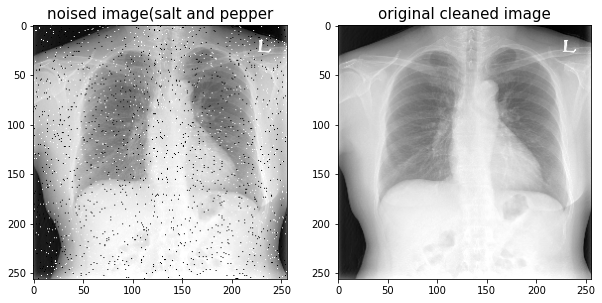

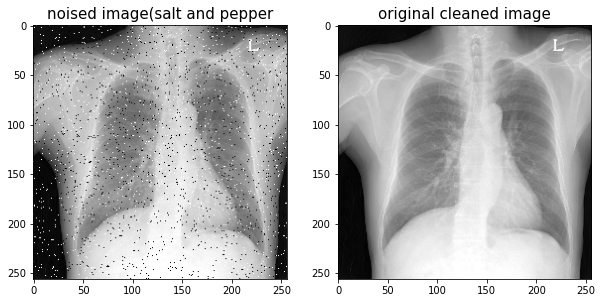

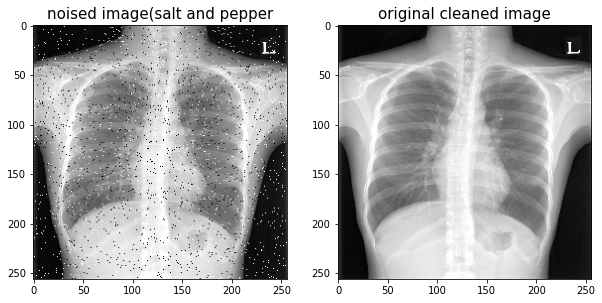

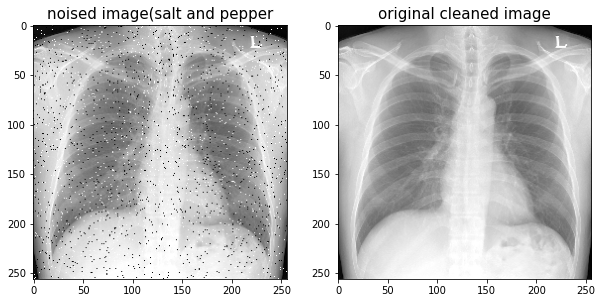

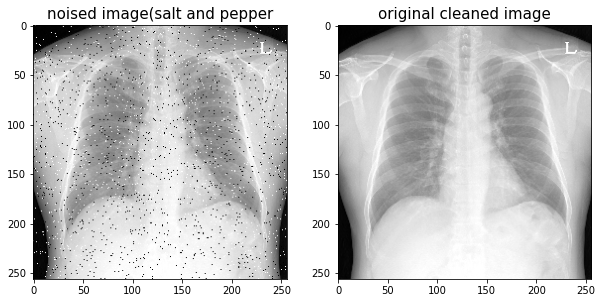

In [ ]:
import cv2
import matplotlib.pyplot as plt

for tmp in range(5):
  testA_img=cv2.imread(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan', 'testA', testA_imglist[tmp]), 0)
  testB_img=cv2.imread(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan', 'testB', testA_imglist[tmp]), 0)#파일명을 A와 같이 해서 비교.
  plt.figure(figsize=(10,10))
  plt.subplot(121)
  plt.title('noised image(salt and pepper', fontsize=15)
  plt.imshow(testA_img, cmap='gray')
  plt.subplot(122)
  plt.title('original cleaned image', fontsize=15)
  plt.imshow(testB_img, cmap='gray')
  plt.show()

In [ ]:
!python train.py --display_id 0 --dataroot handson_data_GAN/promedius_cxr_2000_for_cyclegan --name promedius_cxr_2000_for_cyclegan --model cycle_gan

----------------- Options ---------------
               batch_size: 1                             
                    beta1: 0.5                           
          checkpoints_dir: ./checkpoints                 
           continue_train: False                         
                crop_size: 256                           
                 dataroot: handson_data_GAN/promedius_cxr_2000_for_cyclegan	[default: None]
             dataset_mode: unaligned                     
                direction: AtoB                          
              display_env: main                          
             display_freq: 400                           
               display_id: 0                             	[default: 1]
            display_ncols: 4                             
             display_port: 8097                          
           display_server: http://localhost              
          display_winsize: 256                           
                    epoch: latest        

###작업 로그 및 학습도중 저장된 모델 weight 확인해보기

###학습이 진행되면 아래와 같이 로그가 남음

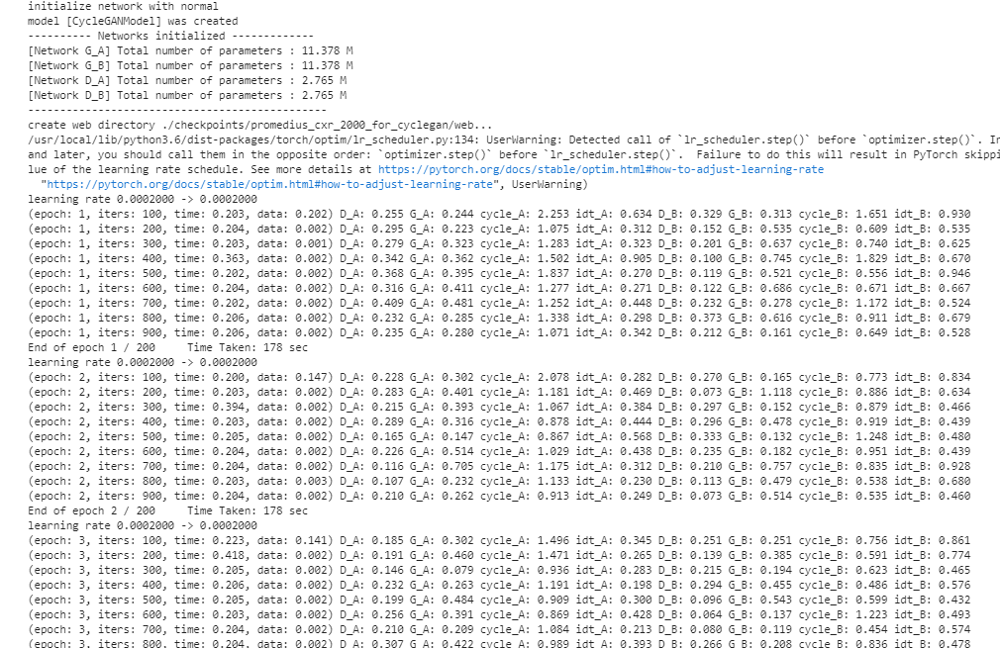

In [ ]:
import shutil
#os.makedirs(os.path.join('weight_and_samples/cyclegan/weight', 'promedius_cxr_2000_for_cyclegan'))
#shutil.copy('weight_and_samples/cyclegan/weight/latest_net_G.pth', os.path.join('weight_and_samples/cyclegan/weight', 'promedius_cxr_2000_for_cyclegan'))
!python test.py --dataroot handson_data_GAN/promedius_cxr_2000_for_cyclegan/testA --name promedius_cxr_2000_for_cyclegan --model test --checkpoints_dir 'weight_and_samples/cyclegan/weight' --results_dir 'results'  --no_dropout --num_test 200

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: weight_and_samples/cyclegan/weight	[default: ./checkpoints]
                crop_size: 256                           
                 dataroot: handson_data_GAN/promedius_cxr_2000_for_cyclegan/testA	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
   

In [ ]:
#이미지 비교 metric 함수(mean squared error와 structural similarity index)
from skimage.metrics import structural_similarity as ssim

def mse(imageA, imageB):
    
    err = np.sum((imageA.astype("float") - imageB.astype("float")) ** 2)
    err /= float(imageA.shape[0] * imageA.shape[1])
    
    return err
def compare_images(imageA, imageB):
    
    mse_value = mse(imageA, imageB)
    ssim_value = ssim(imageA, imageB)
    
    return mse_value, ssim_value

In [ ]:
os.listdir('results/promedius_cxr_2000_for_cyclegan/test_latest')

['index.html', 'images']

MSE of paired image 24.34
SSIM of paired image 91.08


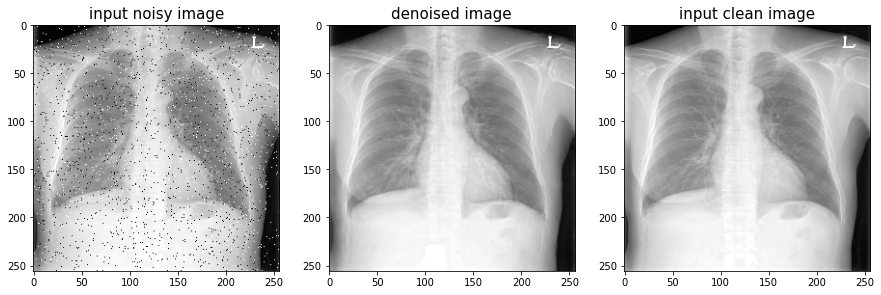

MSE of paired image 61.25
SSIM of paired image 88.69


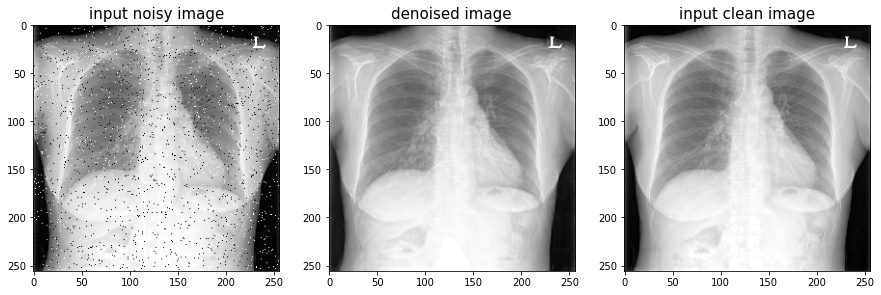

MSE of paired image 79.27
SSIM of paired image 88.55


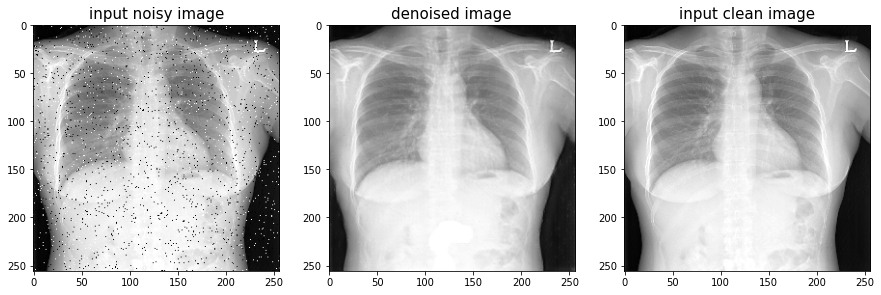

MSE of paired image 95.11
SSIM of paired image 90.49


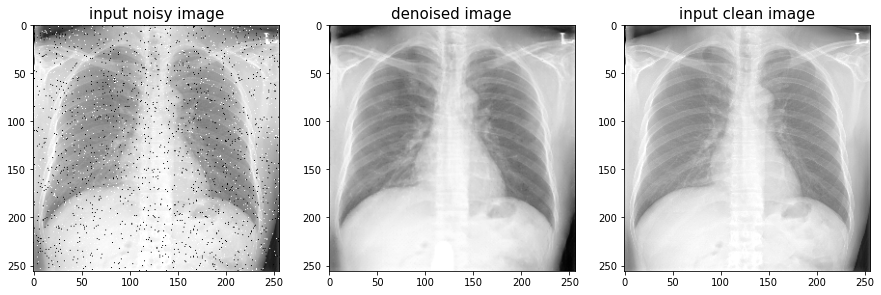

MSE of paired image 25.74
SSIM of paired image 91.2


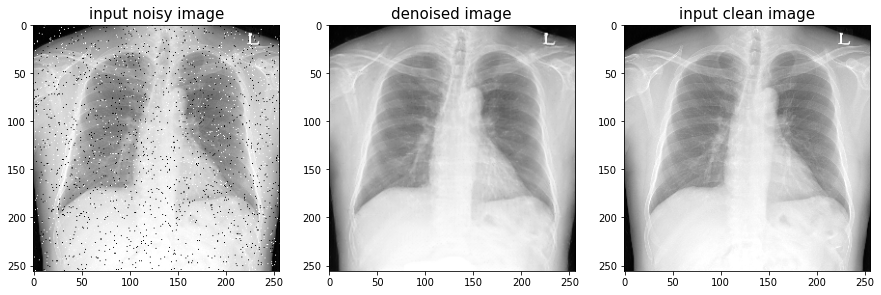

MSE of paired image 27.21
SSIM of paired image 90.68


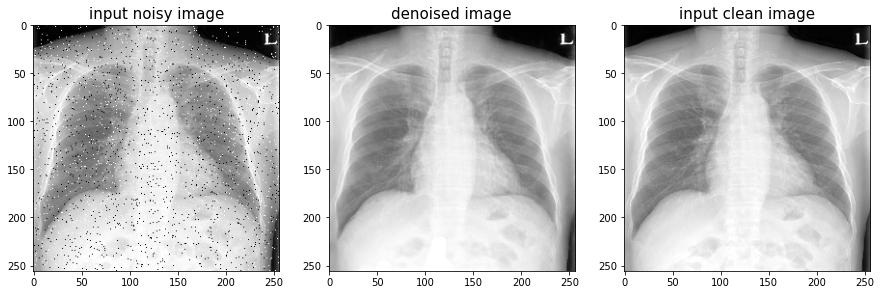

MSE of paired image 158.94
SSIM of paired image 86.46


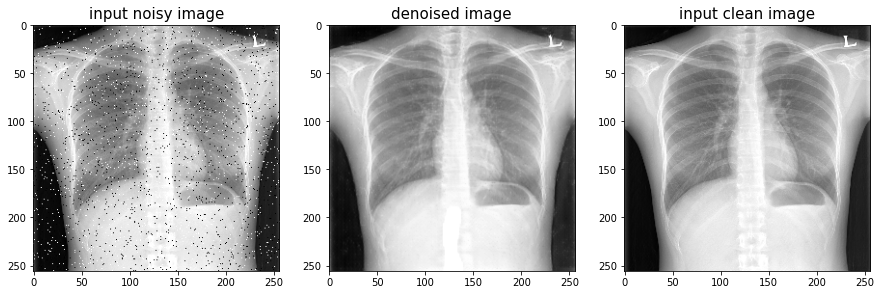

MSE of paired image 37.1
SSIM of paired image 89.93


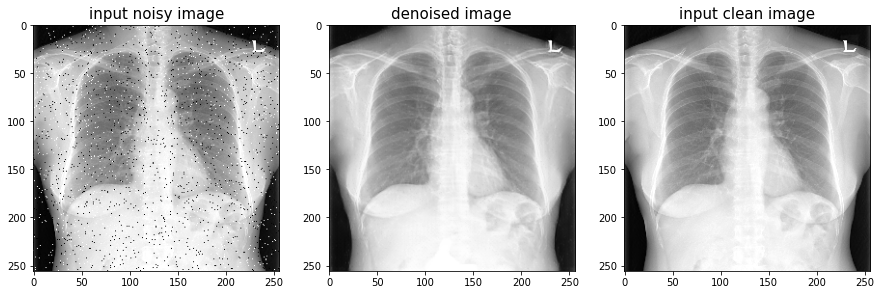

MSE of paired image 35.94
SSIM of paired image 90.37


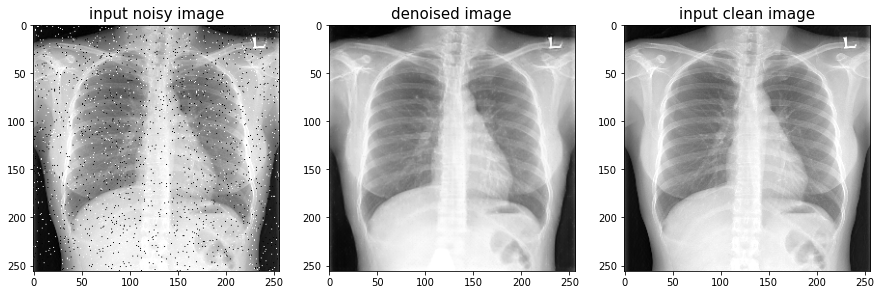

MSE of paired image 27.5
SSIM of paired image 90.81


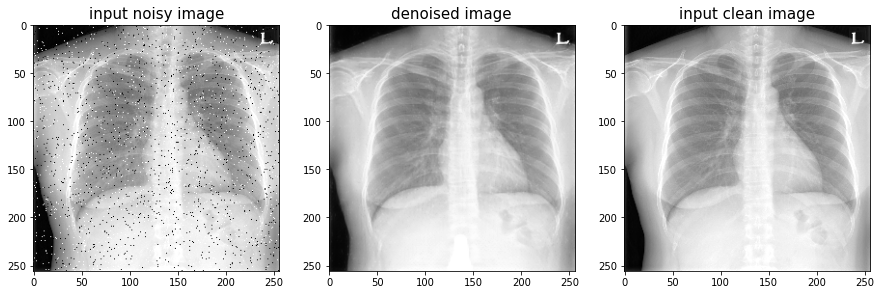

MSE of paired image 70.17
SSIM of paired image 87.43


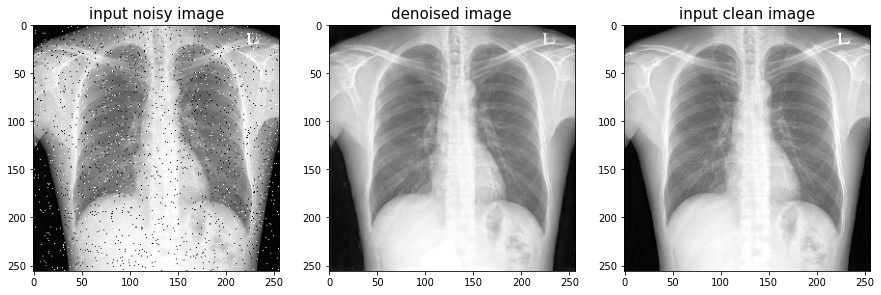

MSE of paired image 29.44
SSIM of paired image 89.4


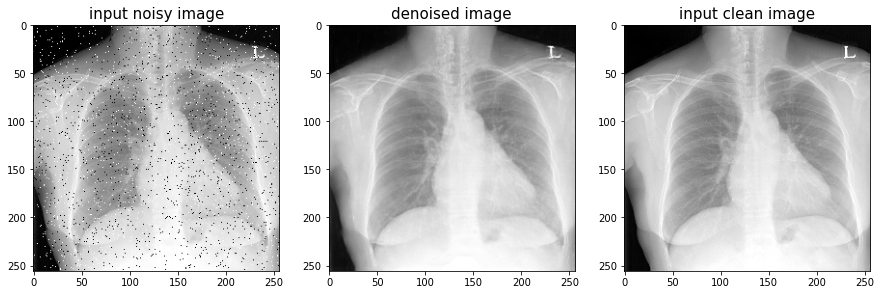

MSE of paired image 45.46
SSIM of paired image 89.63


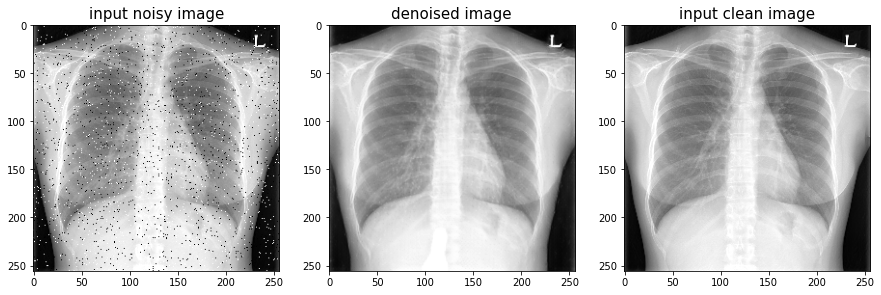

MSE of paired image 27.19
SSIM of paired image 90.56


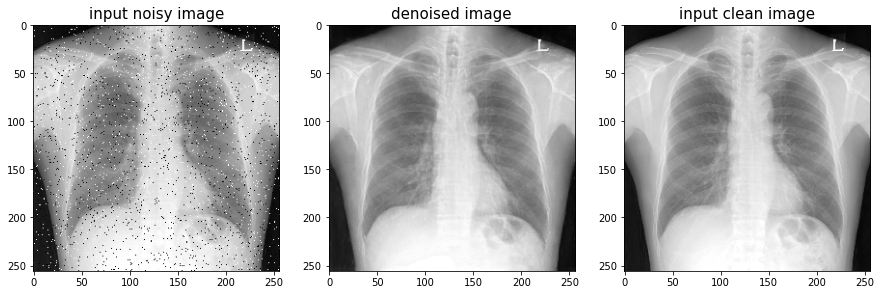

MSE of paired image 42.77
SSIM of paired image 89.73


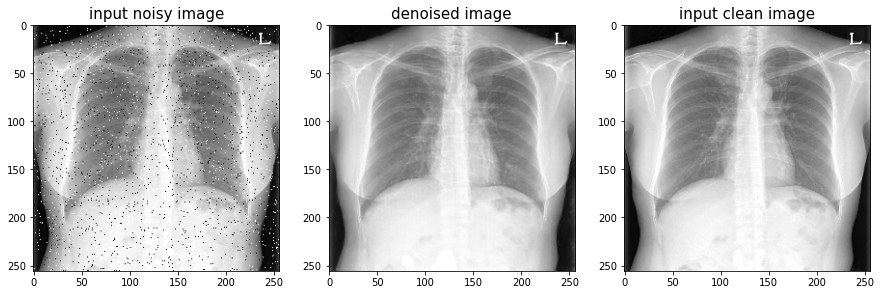

MSE of paired image 32.46
SSIM of paired image 90.36


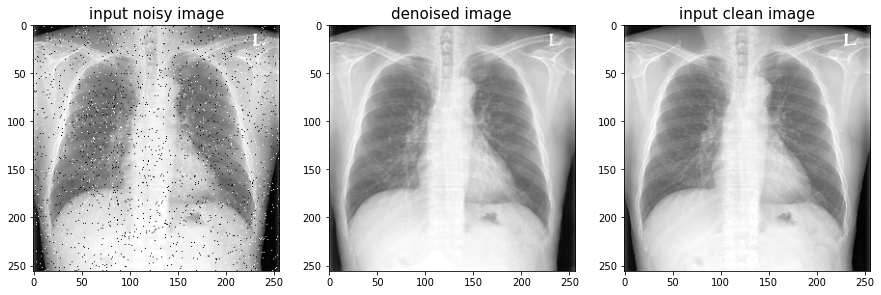

MSE of paired image 377.77
SSIM of paired image 82.44


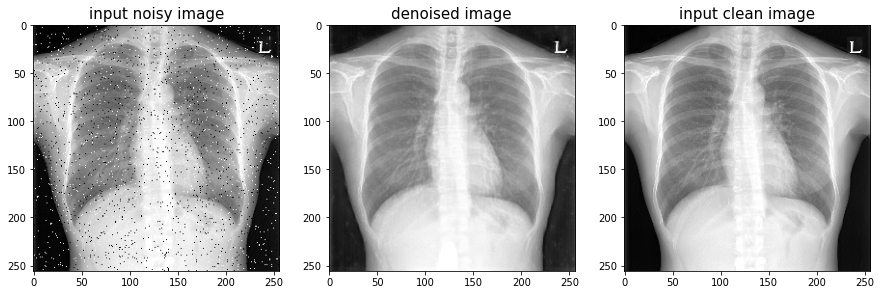

MSE of paired image 35.4
SSIM of paired image 89.39


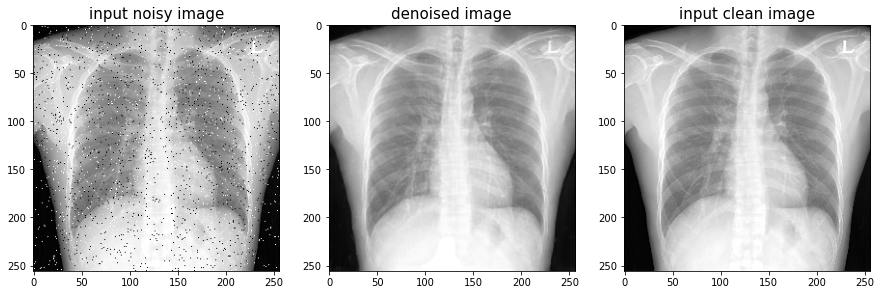

MSE of paired image 57.98
SSIM of paired image 89.23


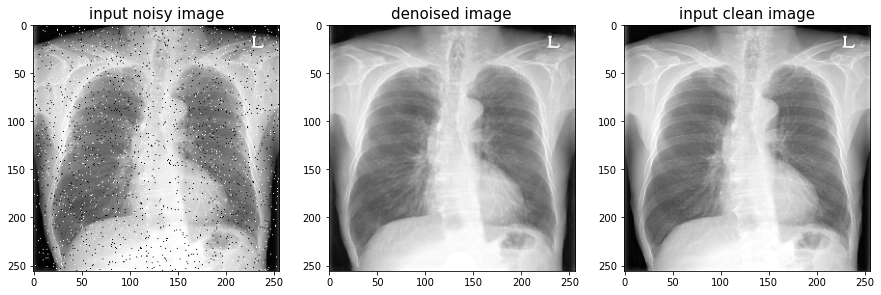

MSE of paired image 115.46
SSIM of paired image 85.81


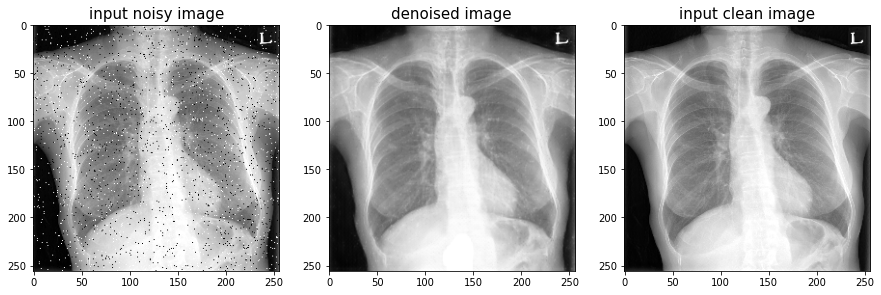

MSE of paired image 24.44
SSIM of paired image 90.86


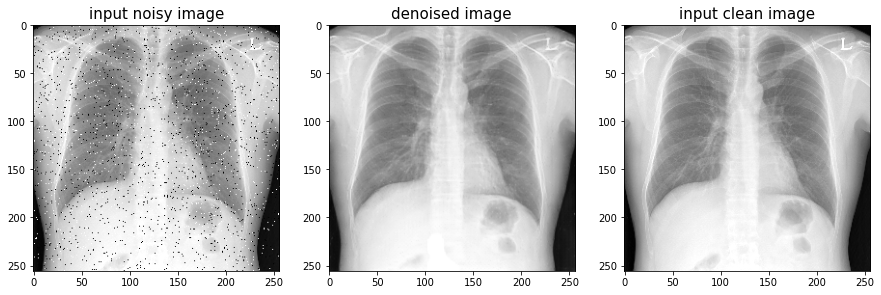

MSE of paired image 30.37
SSIM of paired image 91.05


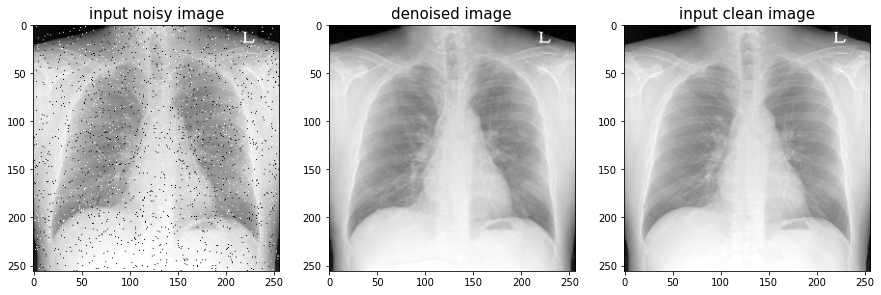

MSE of paired image 31.13
SSIM of paired image 91.39


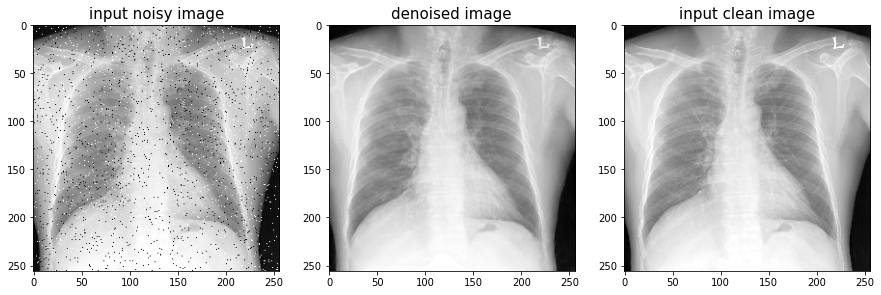

MSE of paired image 28.38
SSIM of paired image 90.65


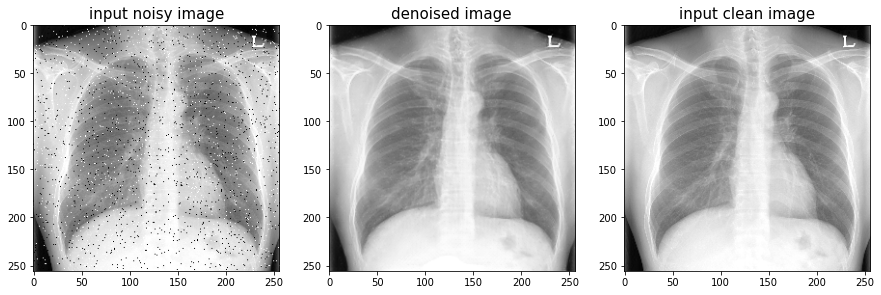

MSE of paired image 55.48
SSIM of paired image 88.94


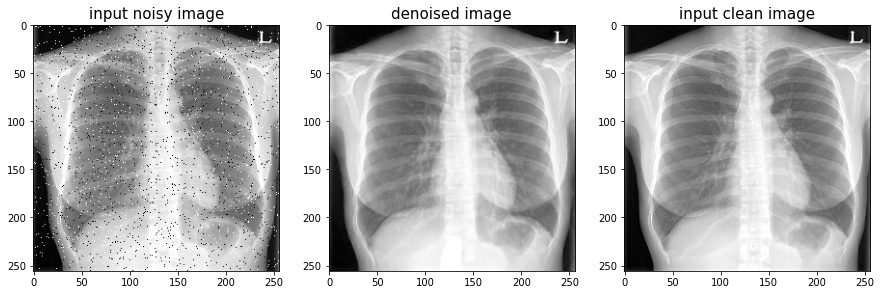

MSE of paired image 41.86
SSIM of paired image 89.45


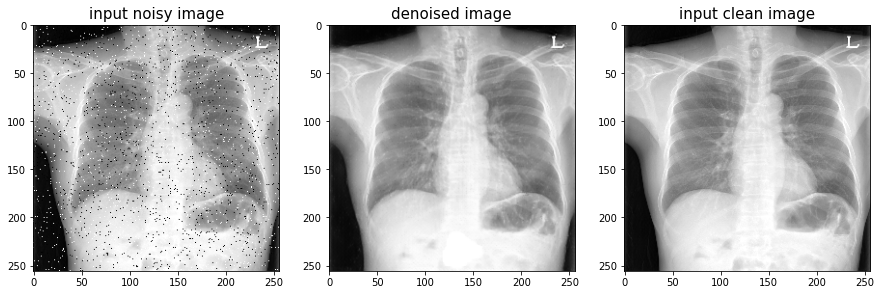

MSE of paired image 227.56
SSIM of paired image 90.75


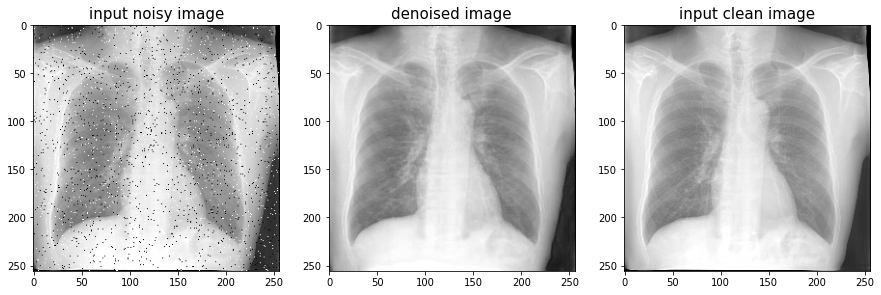

MSE of paired image 455.83
SSIM of paired image 81.62


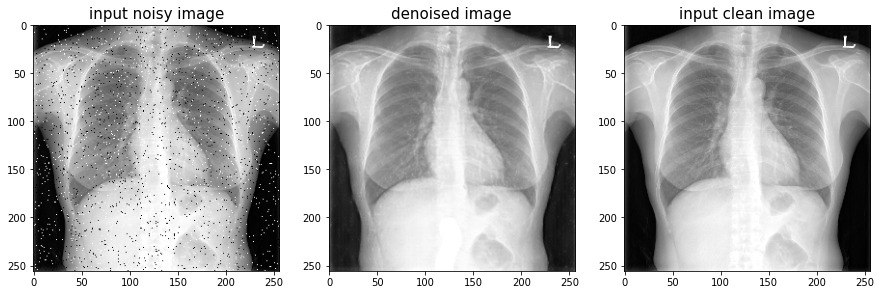

MSE of paired image 111.82
SSIM of paired image 87.85


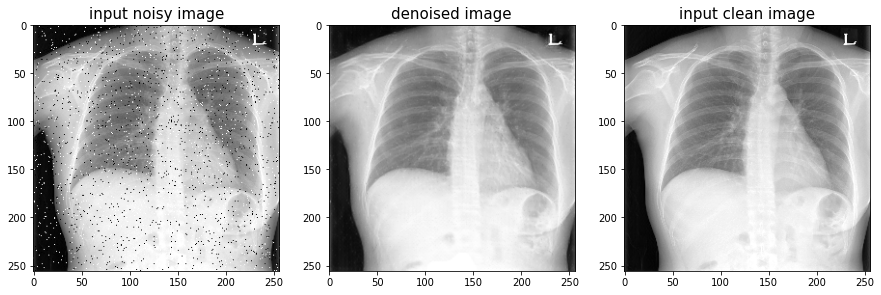

MSE of paired image 34.85
SSIM of paired image 89.89


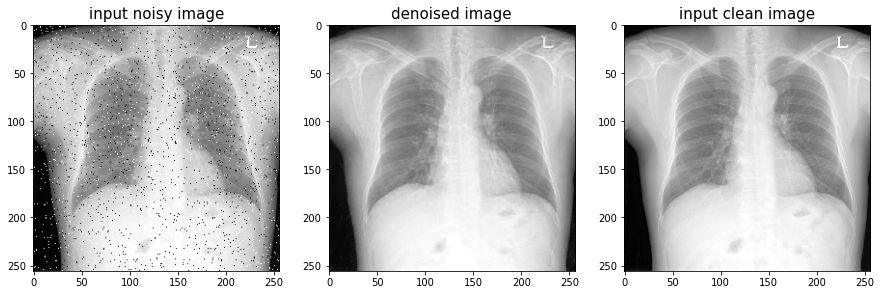

MSE of paired image 247.52
SSIM of paired image 86.64


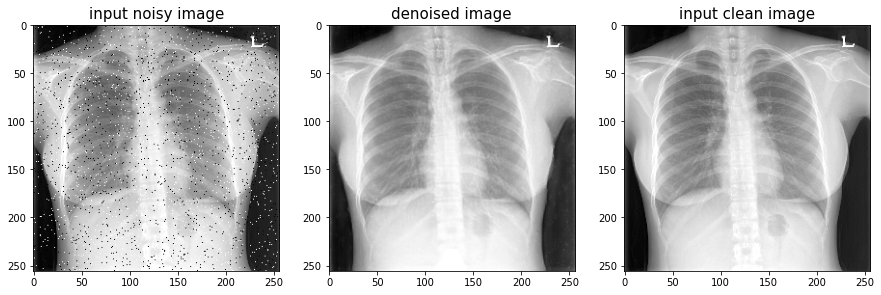

MSE of paired image 23.8
SSIM of paired image 90.68


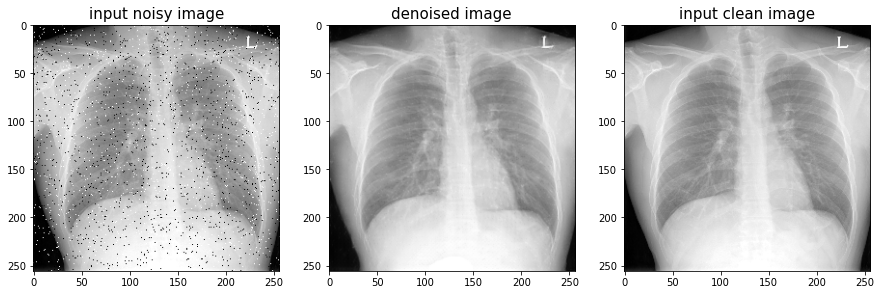

MSE of paired image 57.9
SSIM of paired image 89.64


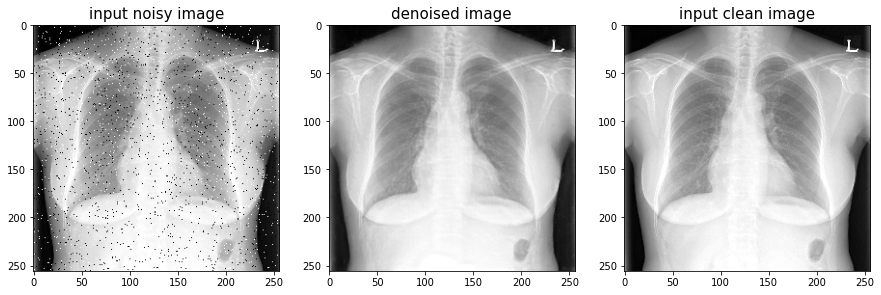

MSE of paired image 18.6
SSIM of paired image 91.81


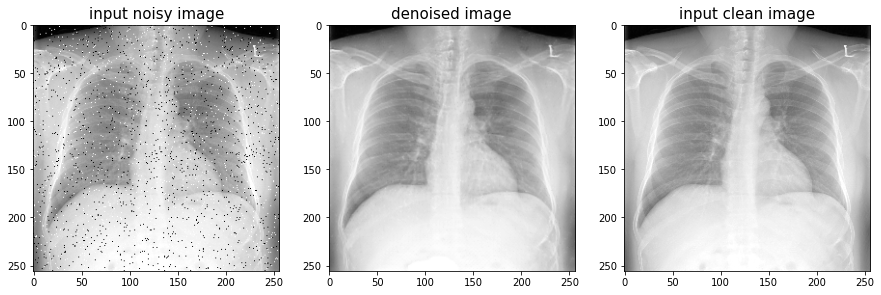

MSE of paired image 16.33
SSIM of paired image 91.9


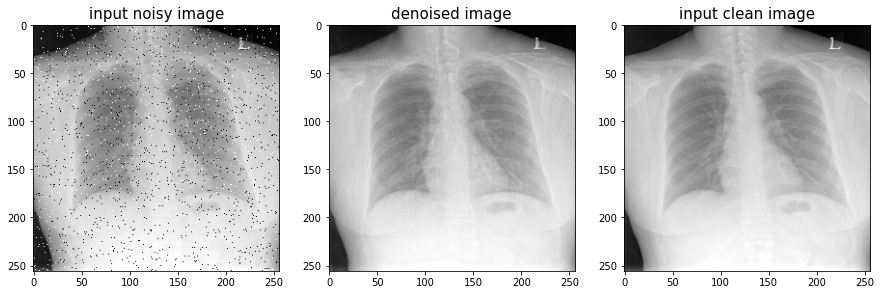

MSE of paired image 19.31
SSIM of paired image 91.69


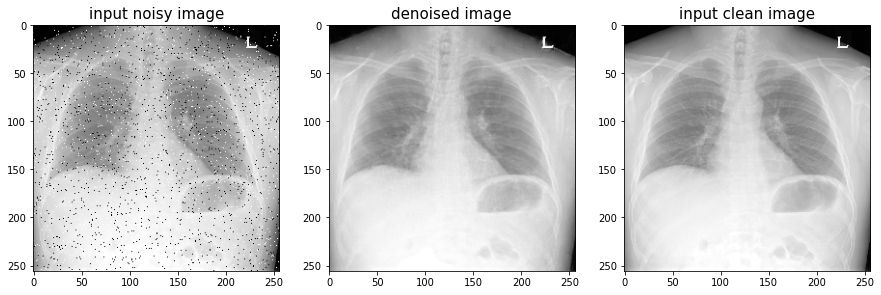

MSE of paired image 25.73
SSIM of paired image 91.14


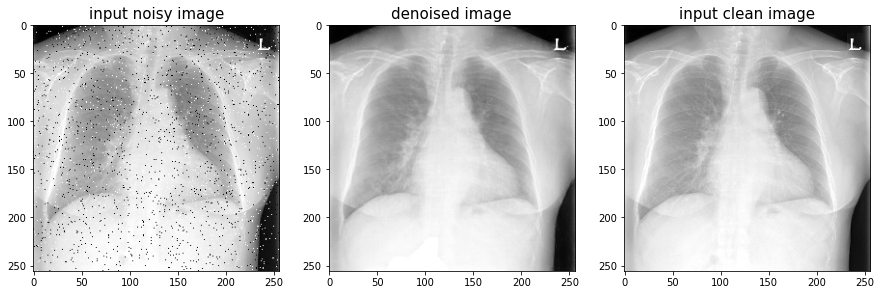

MSE of paired image 17.85
SSIM of paired image 91.92


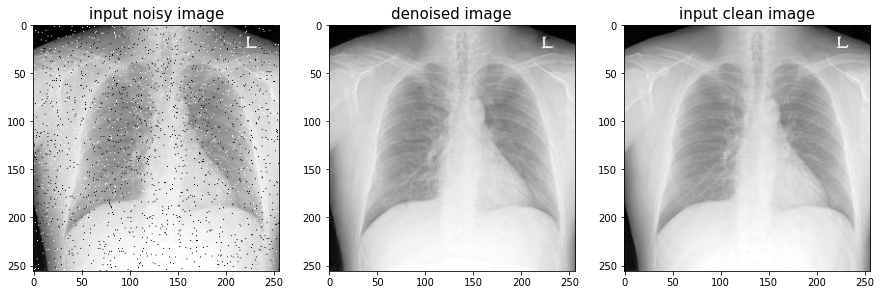

MSE of paired image 23.38
SSIM of paired image 91.31


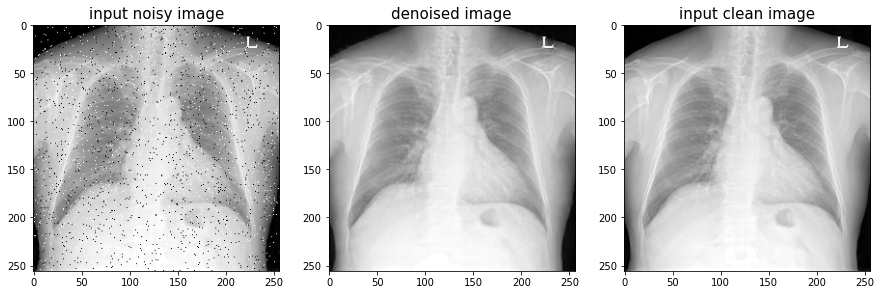

MSE of paired image 23.64
SSIM of paired image 90.76


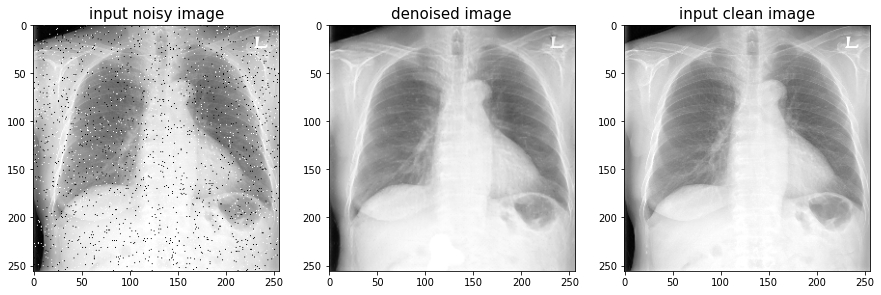

MSE of paired image 22.49
SSIM of paired image 91.23


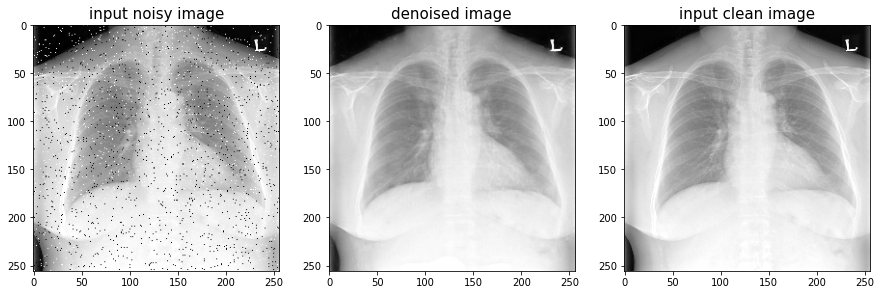

MSE of paired image 112.14
SSIM of paired image 87.1


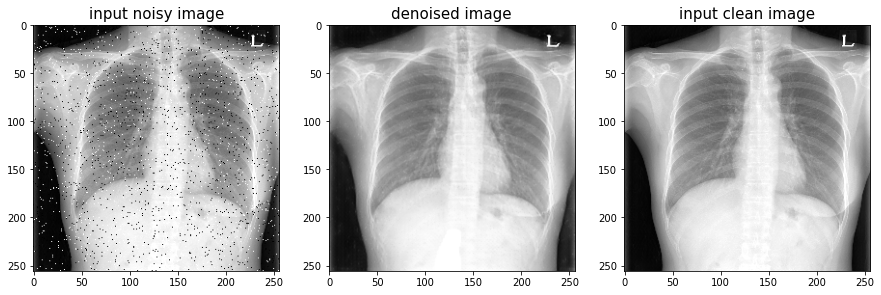

MSE of paired image 24.75
SSIM of paired image 90.88


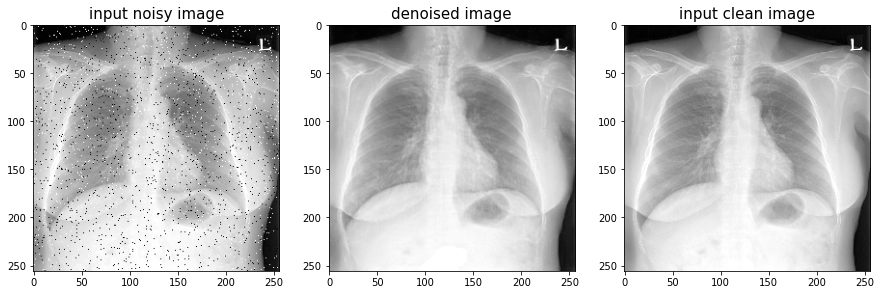

MSE of paired image 23.01
SSIM of paired image 91.29


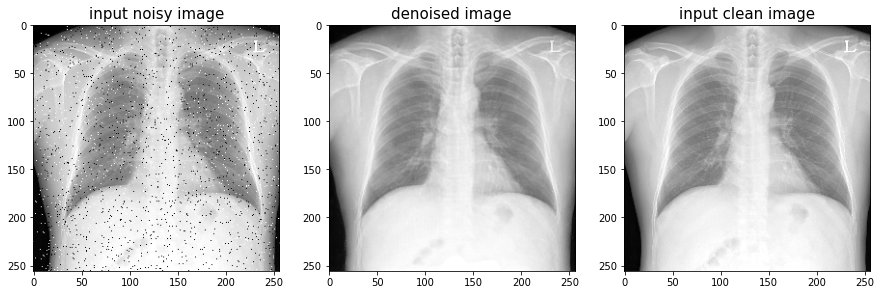

MSE of paired image 62.44
SSIM of paired image 88.95


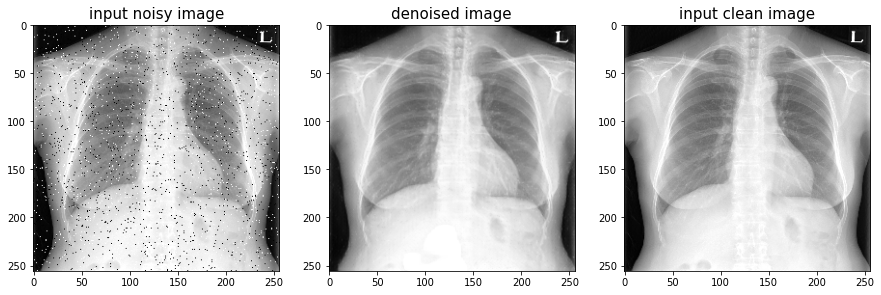

MSE of paired image 21.98
SSIM of paired image 91.61


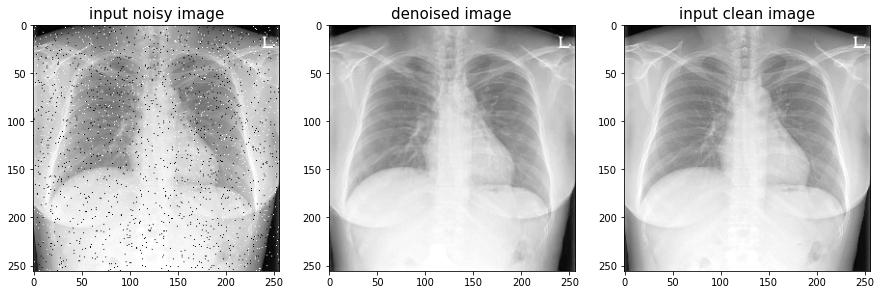

MSE of paired image 24.81
SSIM of paired image 91.12


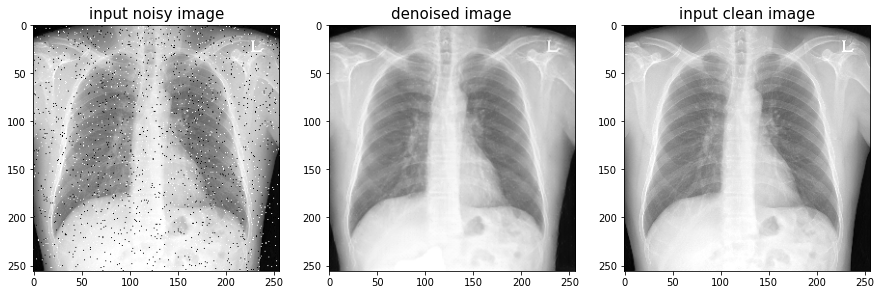

MSE of paired image 33.02
SSIM of paired image 90.91


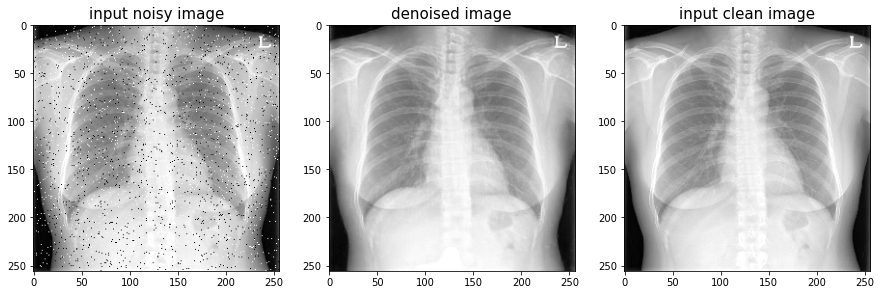

MSE of paired image 24.92
SSIM of paired image 91.85


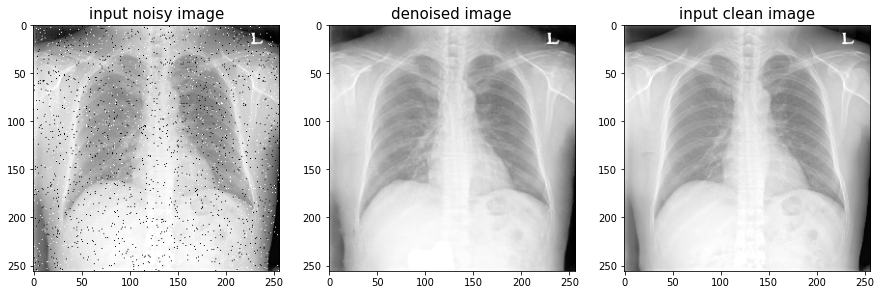

MSE of paired image 113.21
SSIM of paired image 87.38


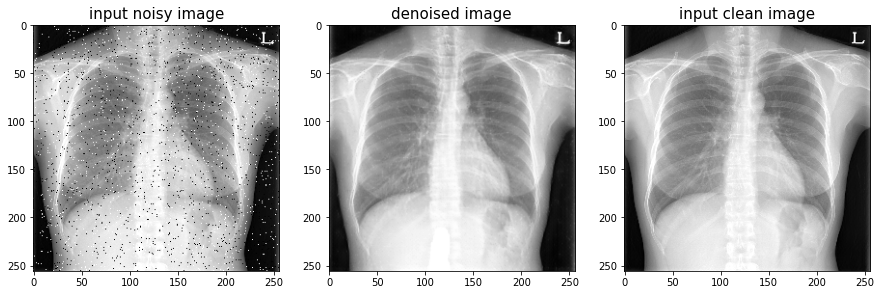

MSE of paired image 54.07
SSIM of paired image 88.82


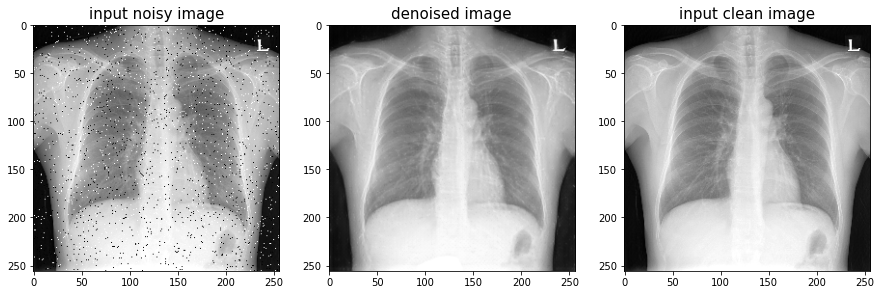

MSE of paired image 70.65
SSIM of paired image 87.09


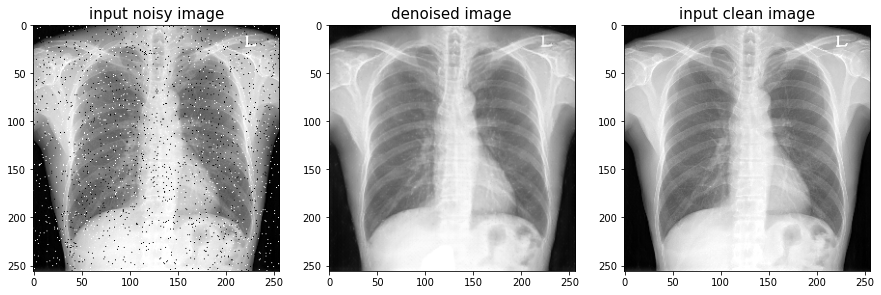

MSE of paired image 28.53
SSIM of paired image 90.36


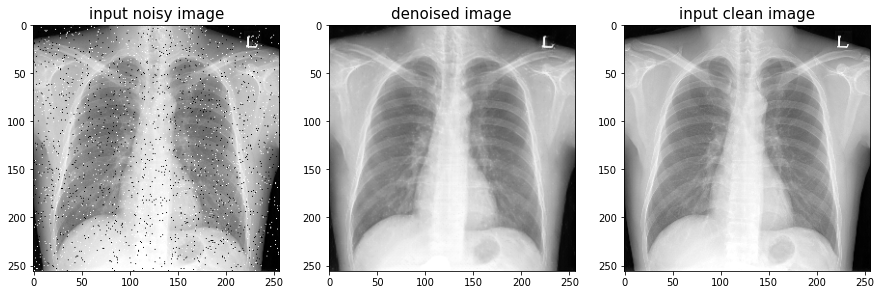

MSE of paired image 64.18
SSIM of paired image 88.99


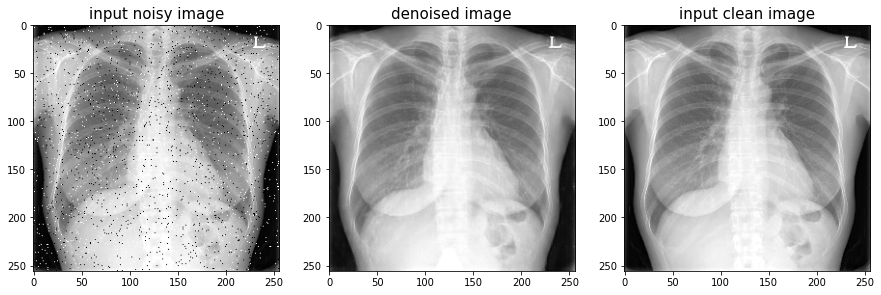

MSE of paired image 22.1
SSIM of paired image 91.81


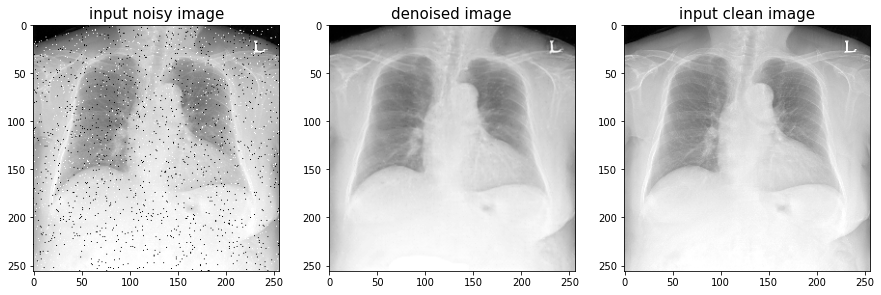

MSE of paired image 687.66
SSIM of paired image 81.03


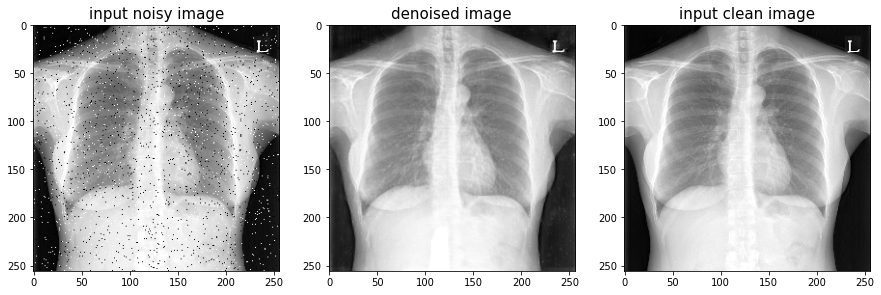

MSE of paired image 1276.71
SSIM of paired image 76.47


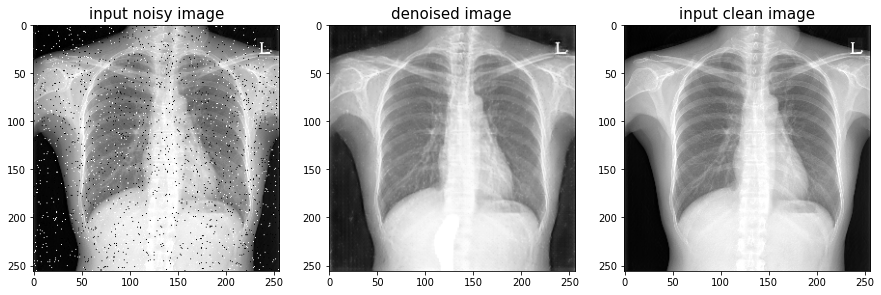

MSE of paired image 28.79
SSIM of paired image 91.02


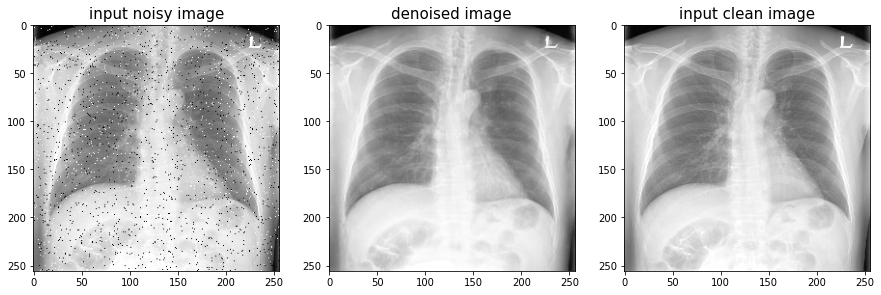

MSE of paired image 32.34
SSIM of paired image 91.0


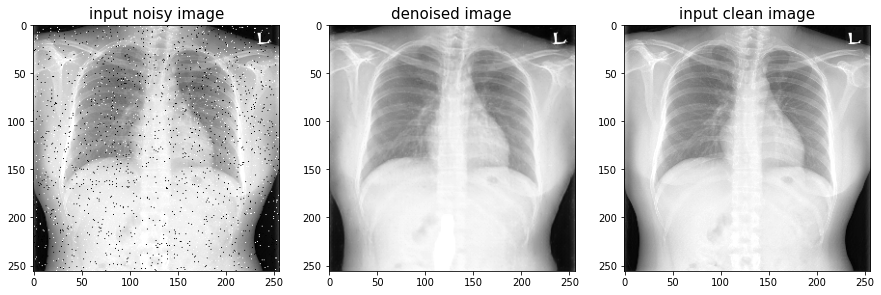

MSE of paired image 103.63
SSIM of paired image 87.22


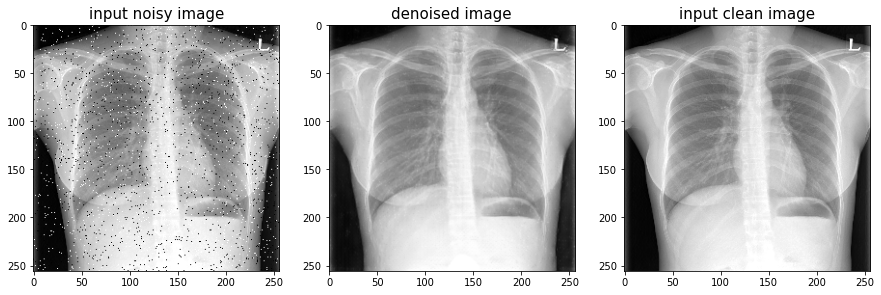

MSE of paired image 40.98
SSIM of paired image 89.48


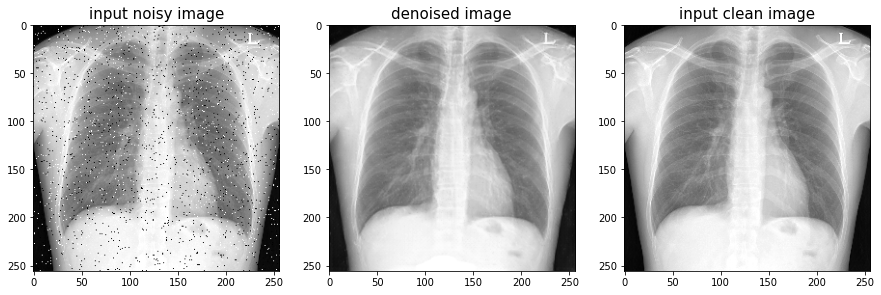

MSE of paired image 43.75
SSIM of paired image 89.88


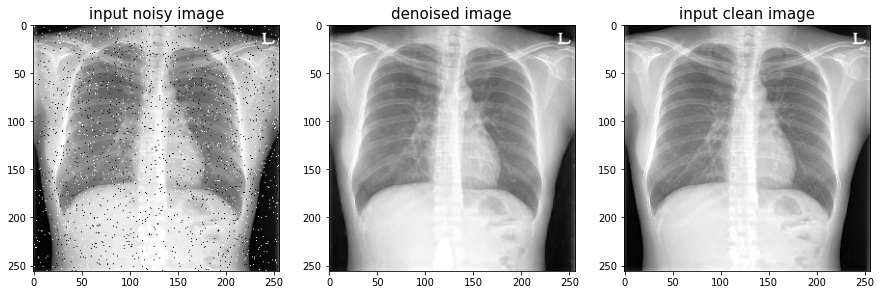

MSE of paired image 20.64
SSIM of paired image 91.26


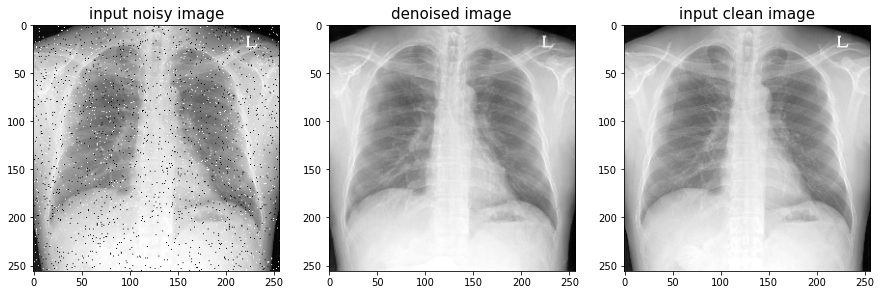

MSE of paired image 49.26
SSIM of paired image 88.63


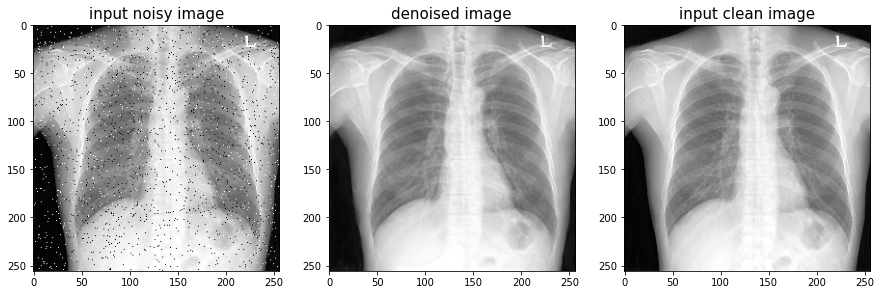

MSE of paired image 1100.05
SSIM of paired image 78.31


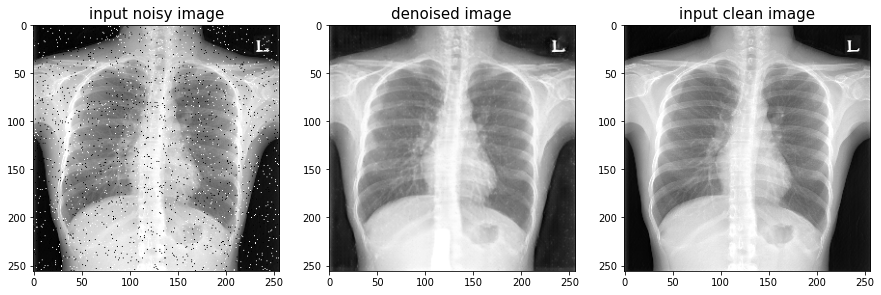

MSE of paired image 24.13
SSIM of paired image 91.32


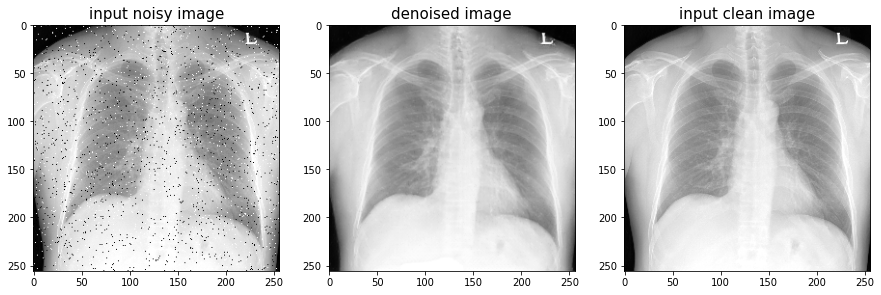

MSE of paired image 19.64
SSIM of paired image 91.51


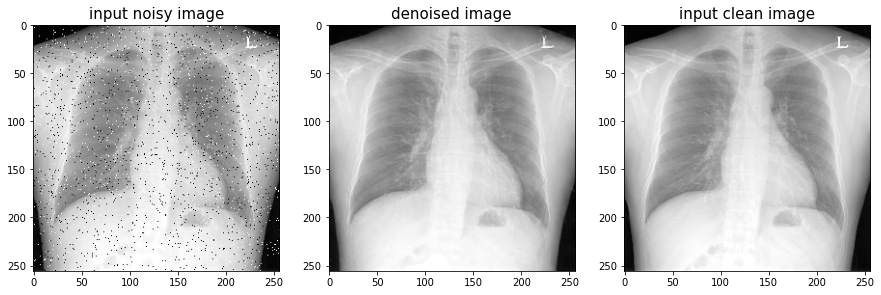

MSE of paired image 27.57
SSIM of paired image 91.32


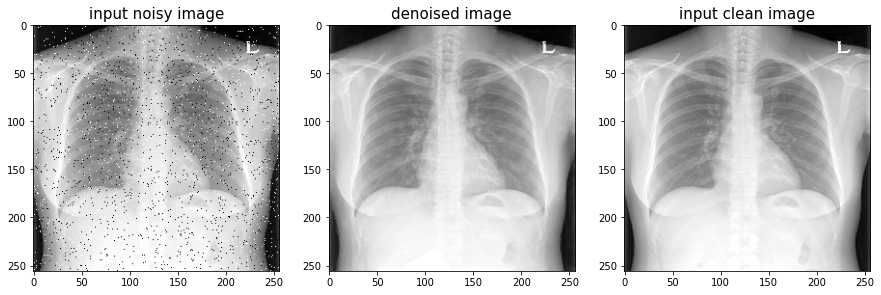

MSE of paired image 56.89
SSIM of paired image 87.67


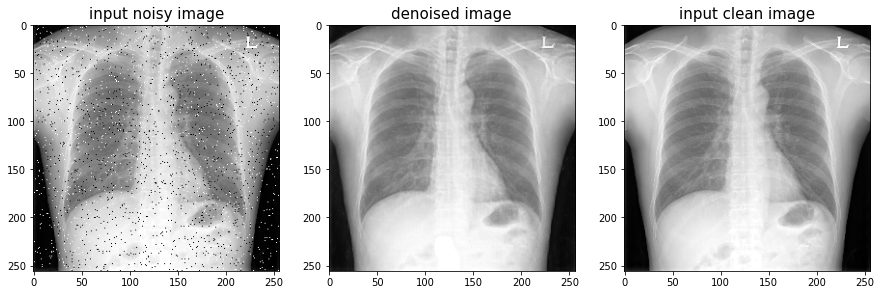

MSE of paired image 23.0
SSIM of paired image 91.02


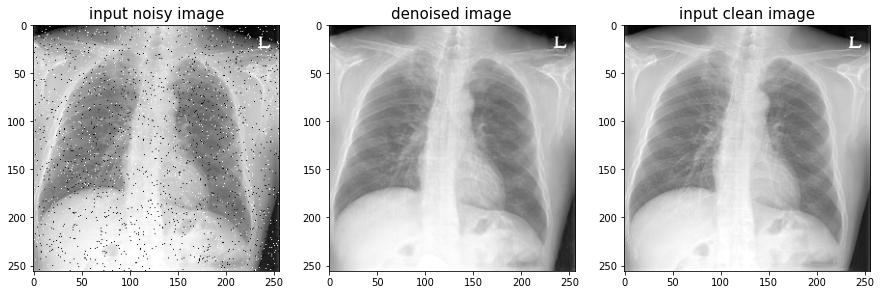

MSE of paired image 25.77
SSIM of paired image 90.9


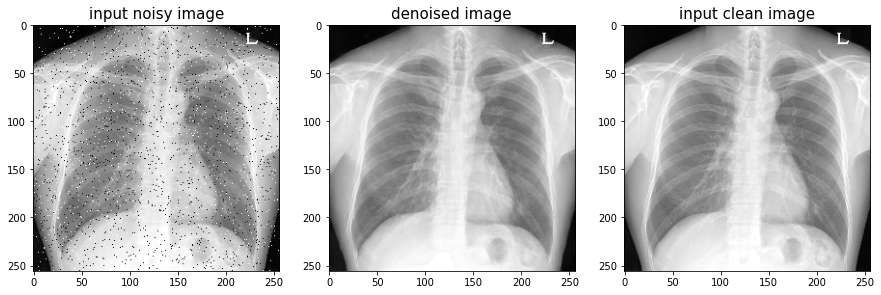

MSE of paired image 110.8
SSIM of paired image 86.2


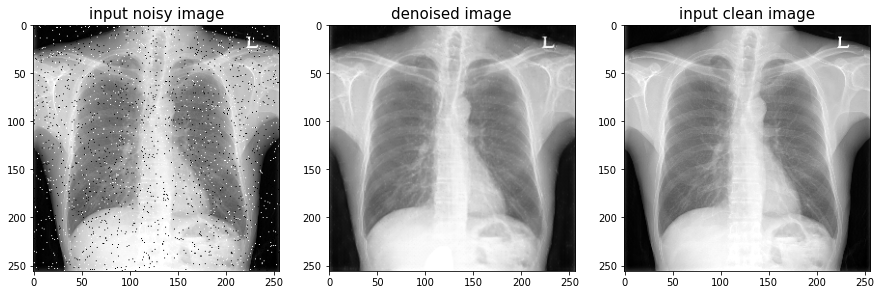

MSE of paired image 25.1
SSIM of paired image 90.99


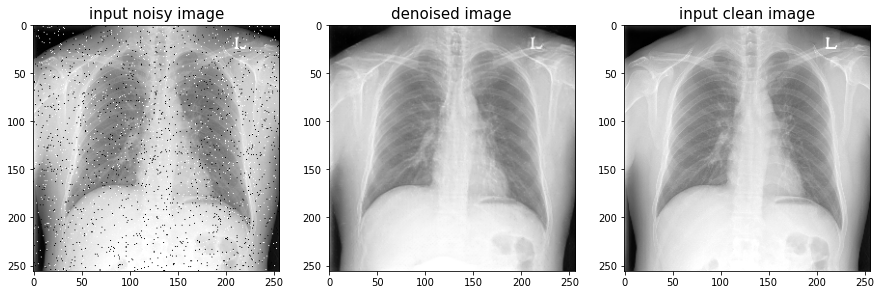

MSE of paired image 30.97
SSIM of paired image 90.04


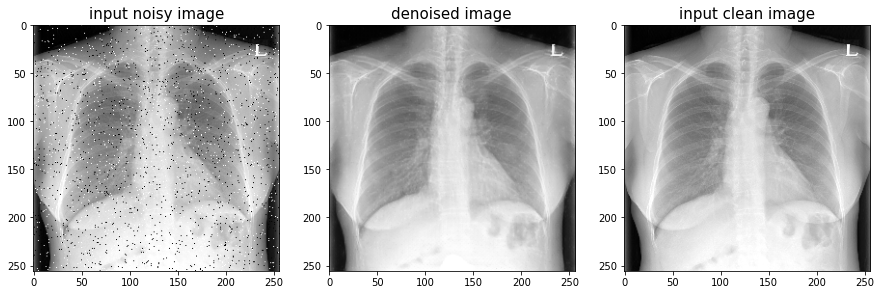

MSE of paired image 38.01
SSIM of paired image 89.93


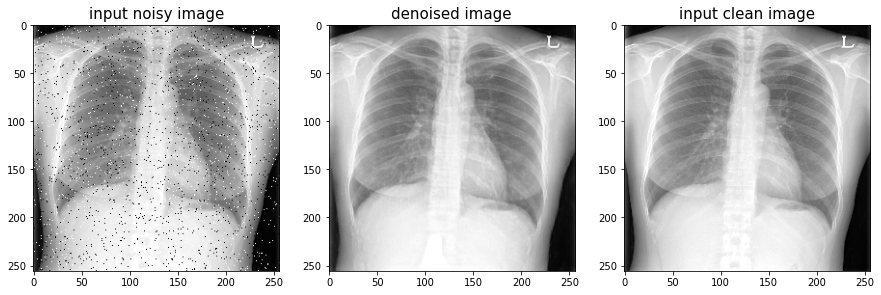

MSE of paired image 31.06
SSIM of paired image 90.94


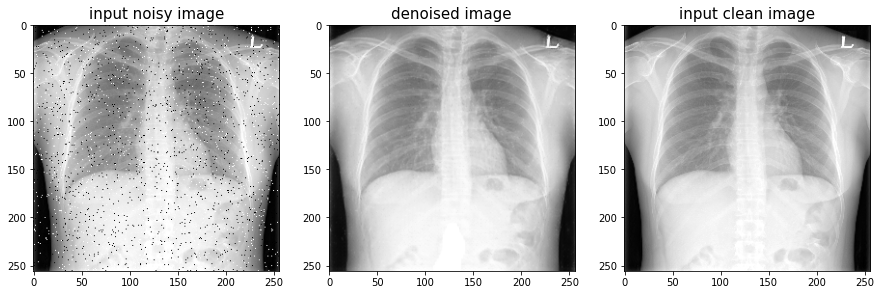

MSE of paired image 35.67
SSIM of paired image 89.82


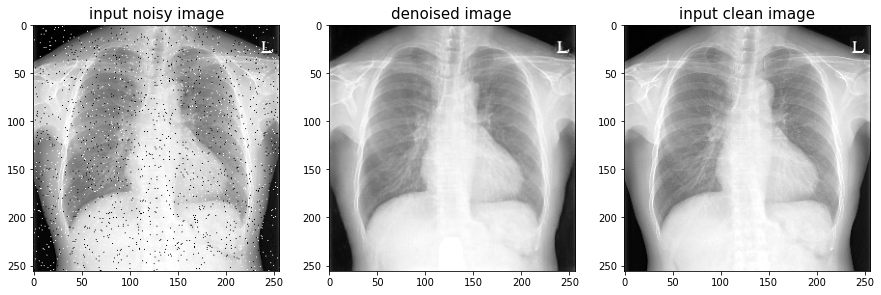

MSE of paired image 1695.45
SSIM of paired image 75.88


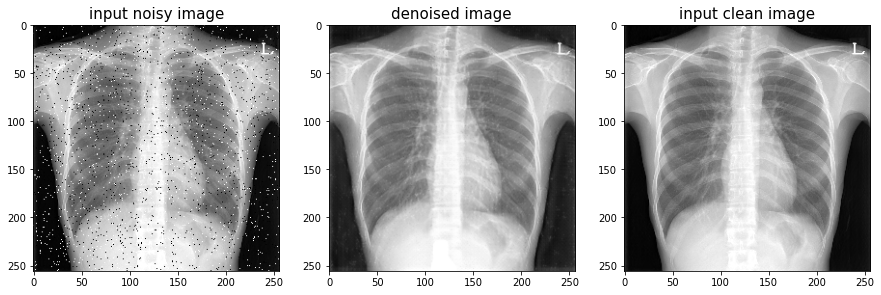

MSE of paired image 20.0
SSIM of paired image 91.96


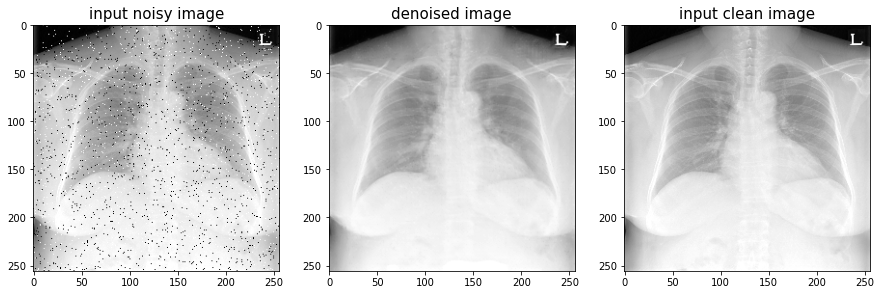

MSE of paired image 25.48
SSIM of paired image 90.86


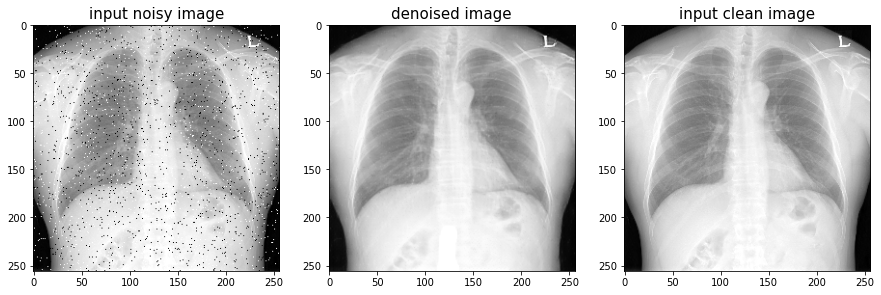

MSE of paired image 22.47
SSIM of paired image 91.76


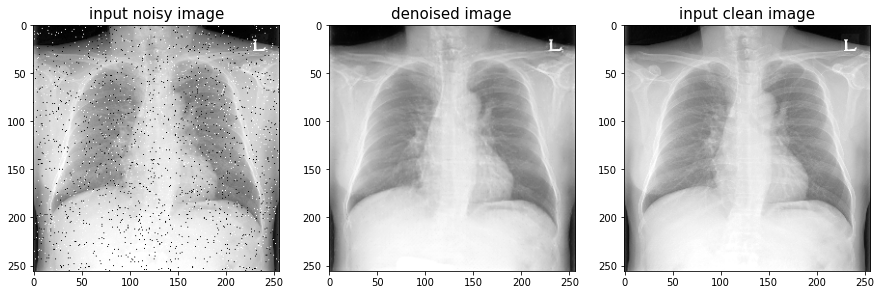

MSE of paired image 25.99
SSIM of paired image 90.77


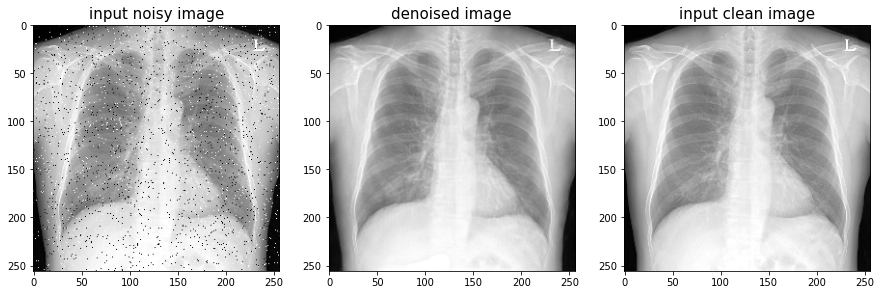

MSE of paired image 23.49
SSIM of paired image 91.37


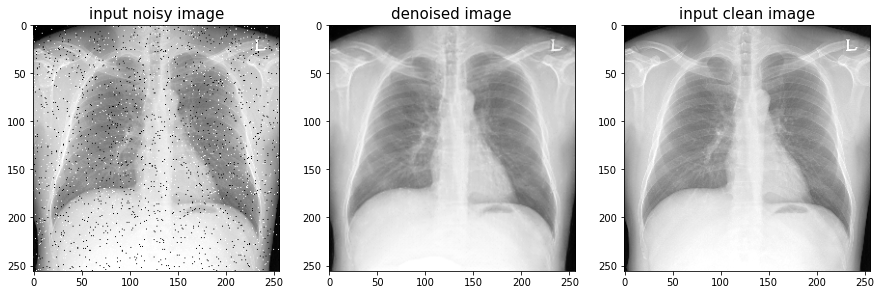

MSE of paired image 65.9
SSIM of paired image 88.04


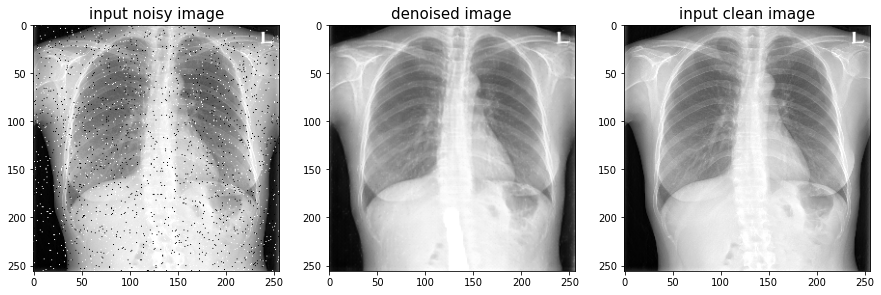

MSE of paired image 24.94
SSIM of paired image 91.26


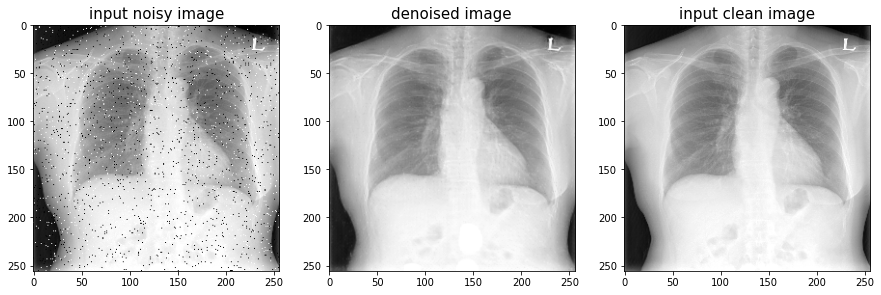

MSE of paired image 57.31
SSIM of paired image 88.7


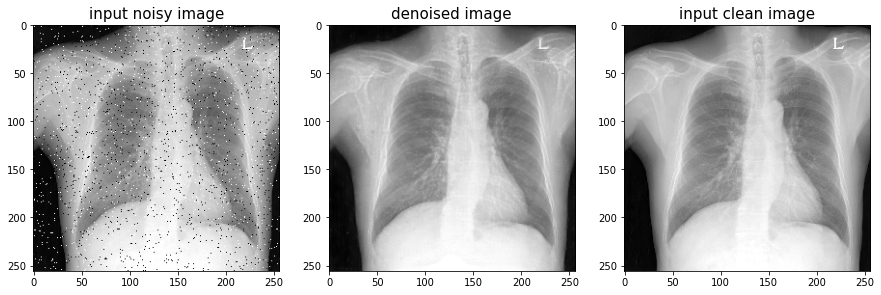

MSE of paired image 26.16
SSIM of paired image 91.34


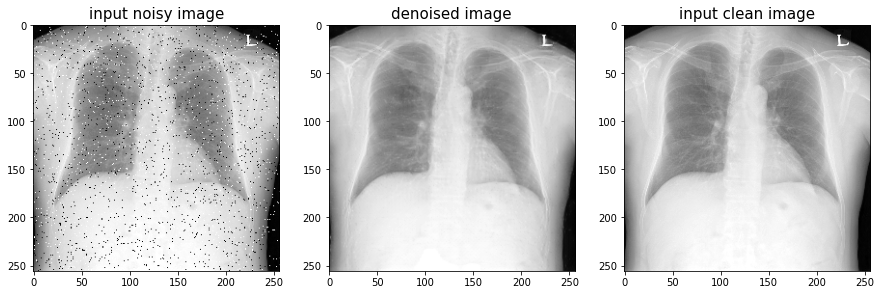

MSE of paired image 47.6
SSIM of paired image 89.09


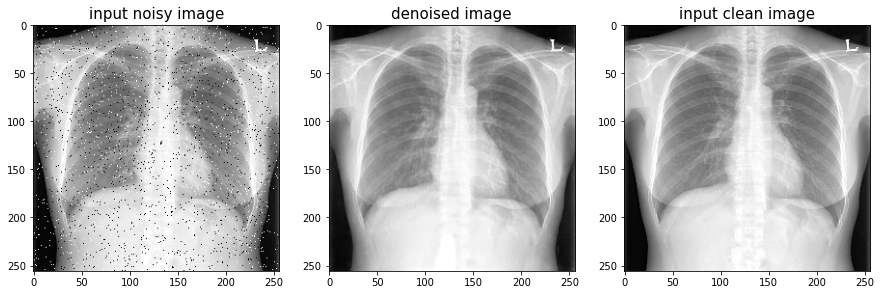

MSE of paired image 29.1
SSIM of paired image 90.68


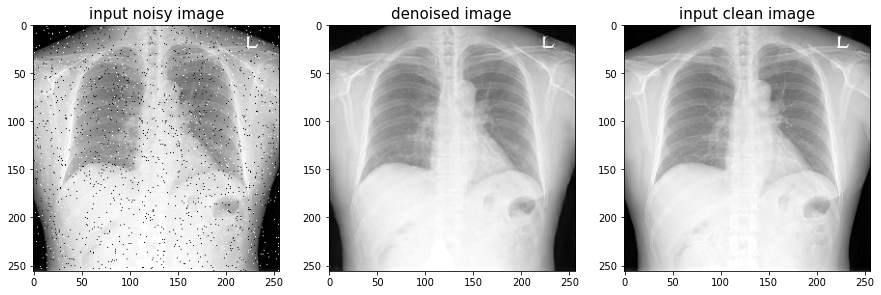

MSE of paired image 21.57
SSIM of paired image 91.38


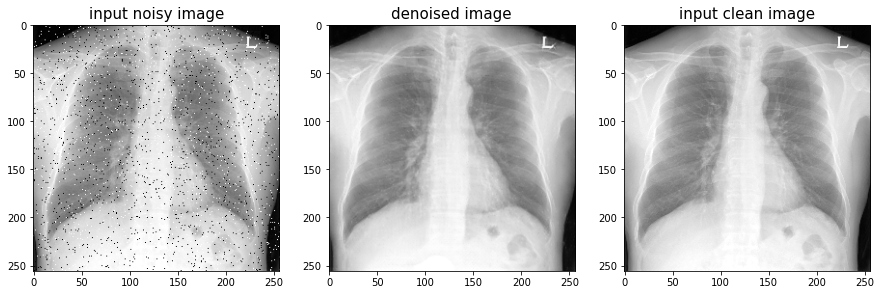

MSE of paired image 62.28
SSIM of paired image 88.47


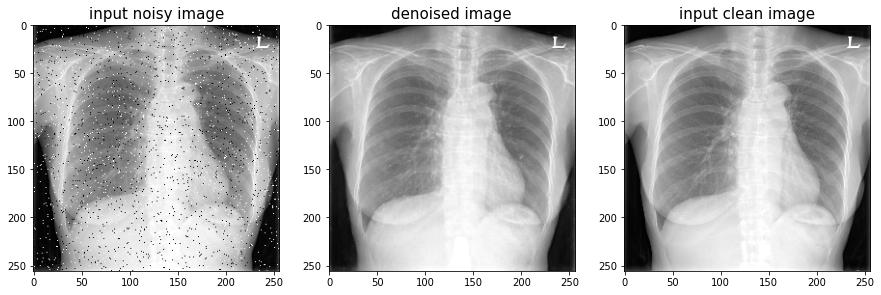

MSE of paired image 40.1
SSIM of paired image 90.26


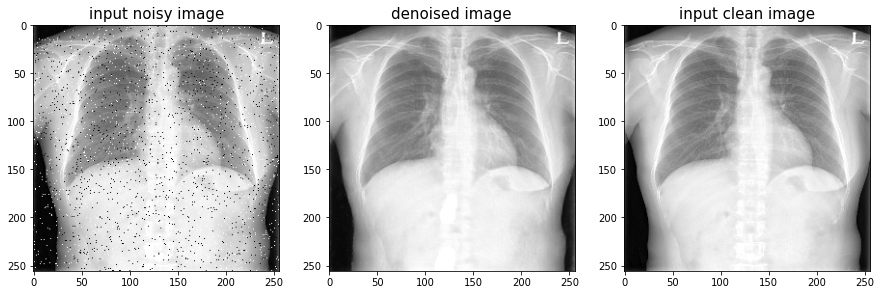

MSE of paired image 37.67
SSIM of paired image 90.62


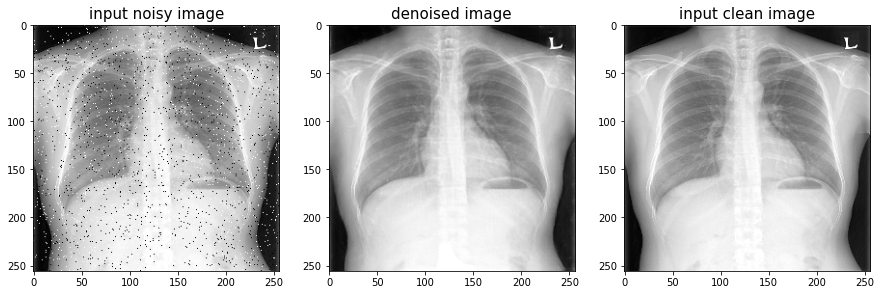

MSE of paired image 28.91
SSIM of paired image 90.93


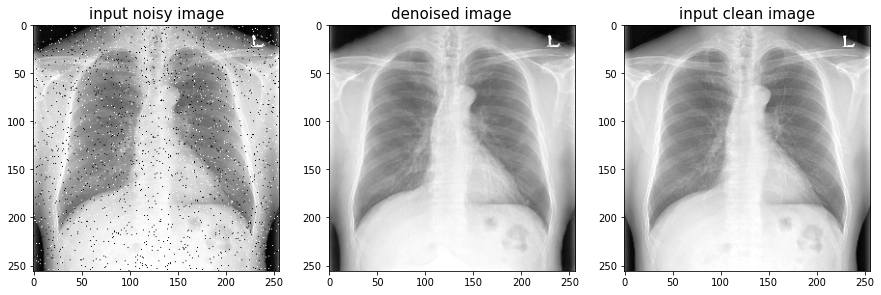

MSE of paired image 25.91
SSIM of paired image 91.38


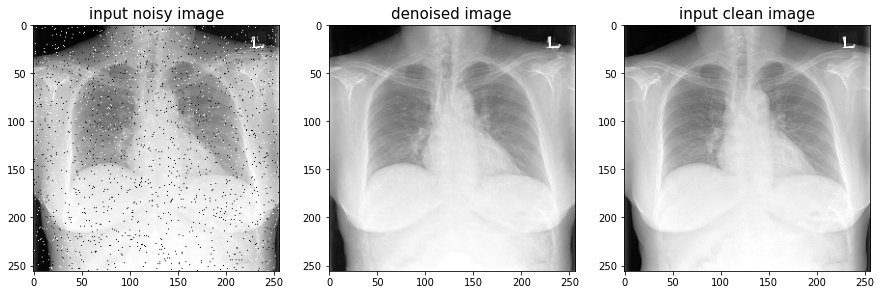

MSE of paired image 41.87
SSIM of paired image 90.04


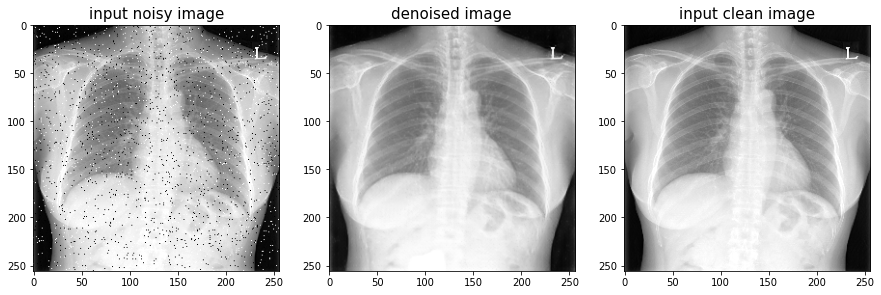

MSE of paired image 31.06
SSIM of paired image 90.64


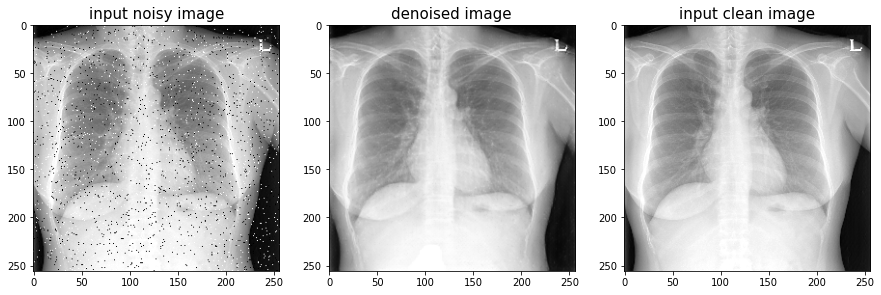

MSE of paired image 31.23
SSIM of paired image 89.99


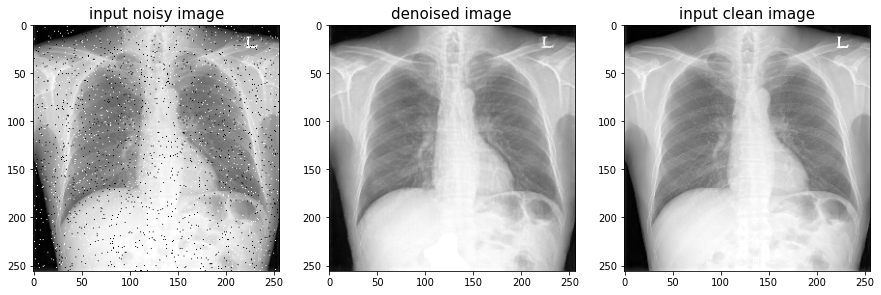

MSE of paired image 24.98
SSIM of paired image 91.08


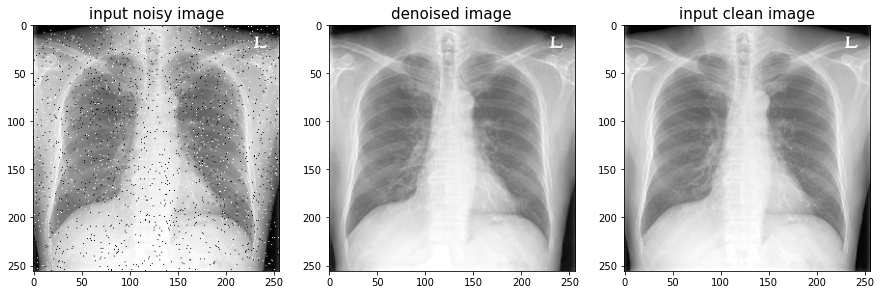

MSE of paired image 25.97
SSIM of paired image 90.32


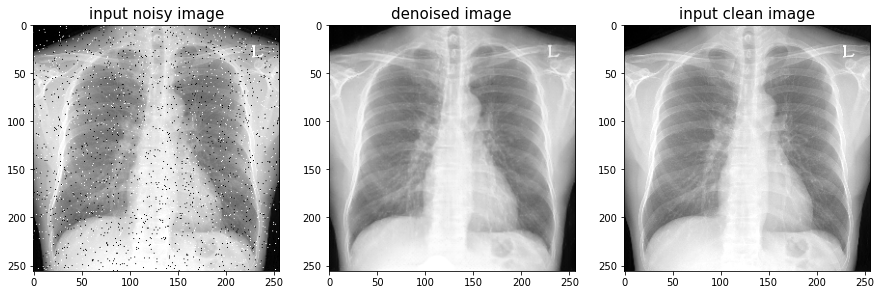

MSE of paired image 26.26
SSIM of paired image 90.69


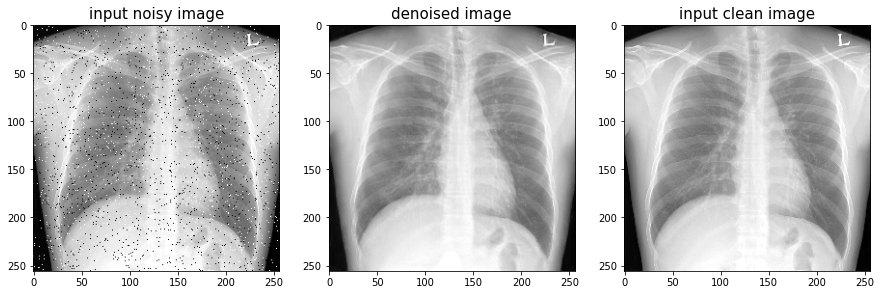

MSE of paired image 71.79
SSIM of paired image 88.12


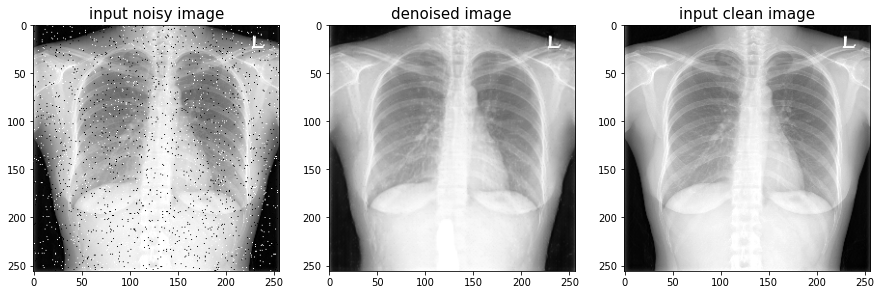

MSE of paired image 22.57
SSIM of paired image 90.89


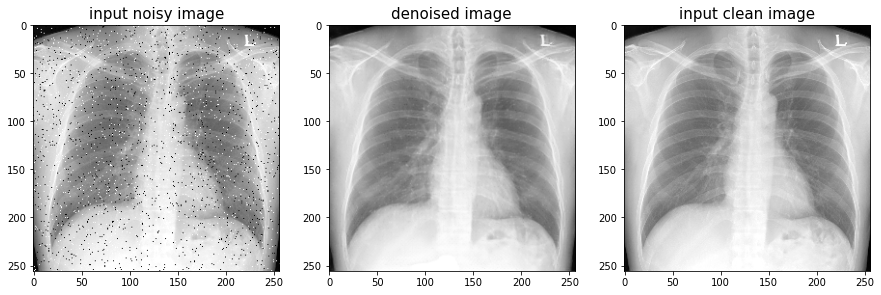

MSE of paired image 28.89
SSIM of paired image 90.68


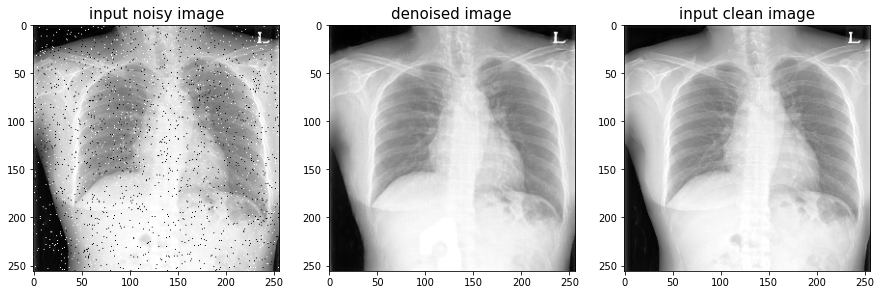

MSE of paired image 89.19
SSIM of paired image 87.29


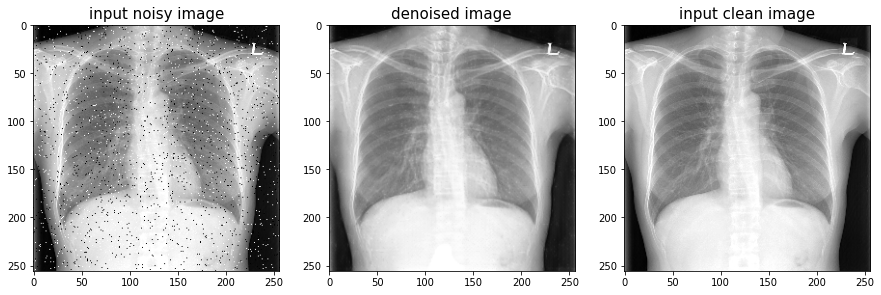

MSE of paired image 24.82
SSIM of paired image 90.8


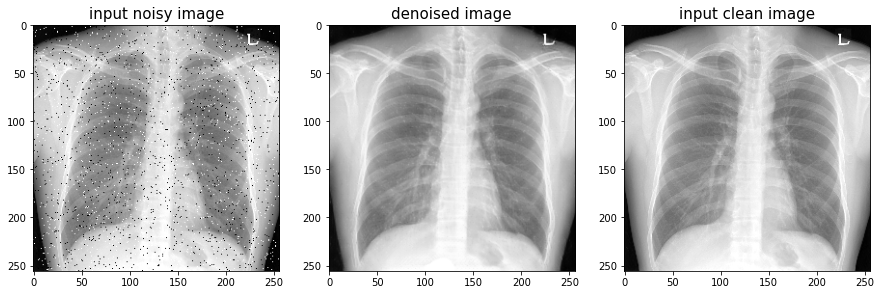

MSE of paired image 21.26
SSIM of paired image 91.88


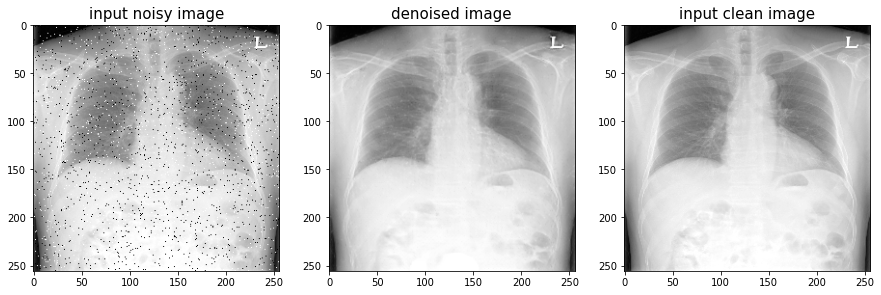

MSE of paired image 45.64
SSIM of paired image 89.23


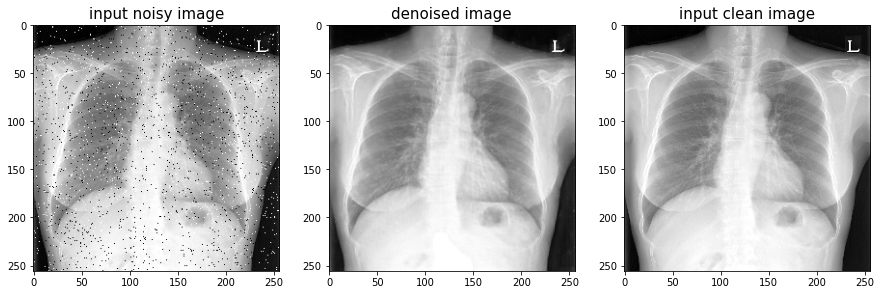

MSE of paired image 16.53
SSIM of paired image 92.4


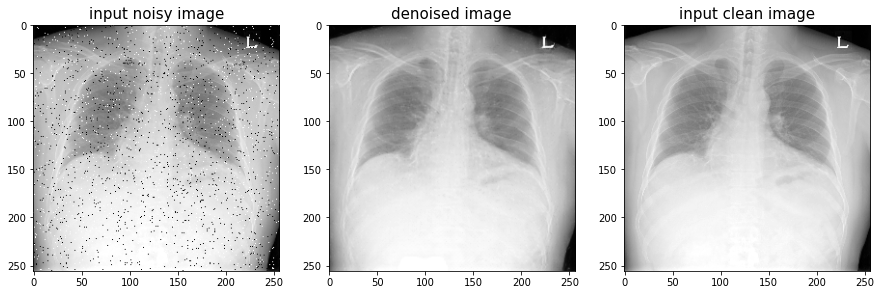

MSE of paired image 54.08
SSIM of paired image 90.43


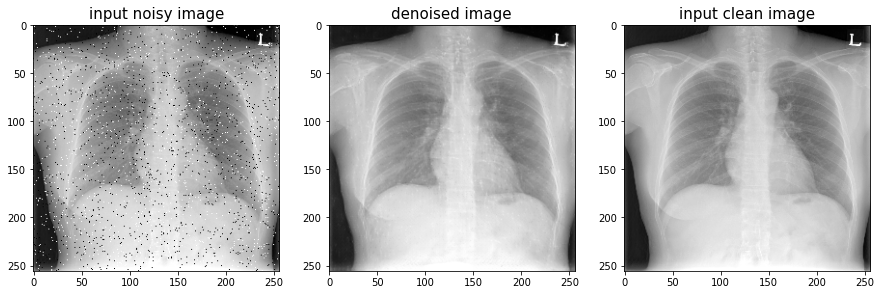

MSE of paired image 24.57
SSIM of paired image 91.82


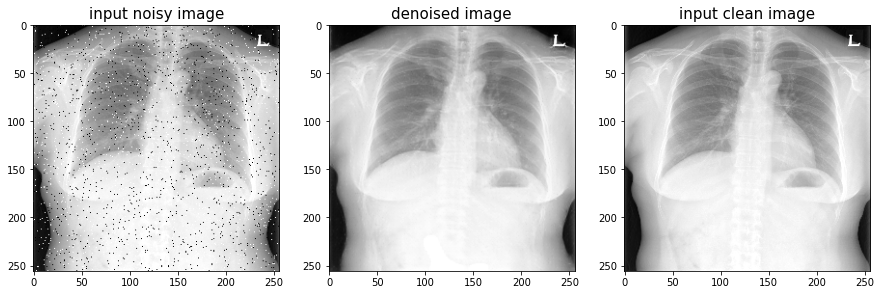

MSE of paired image 27.55
SSIM of paired image 90.82


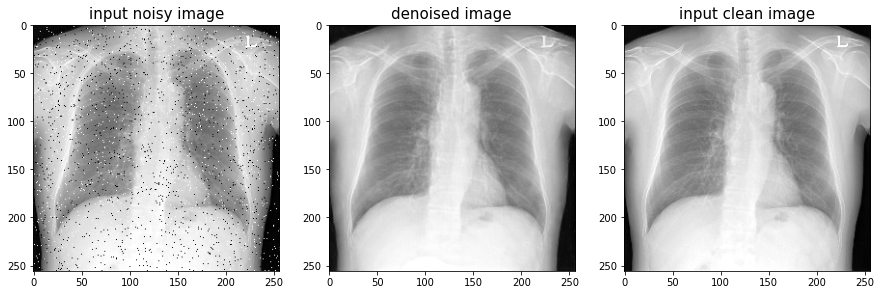

MSE of paired image 392.49
SSIM of paired image 83.09


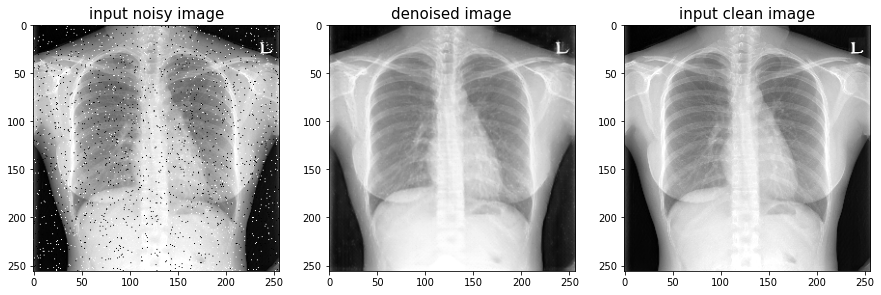

MSE of paired image 136.1
SSIM of paired image 91.66


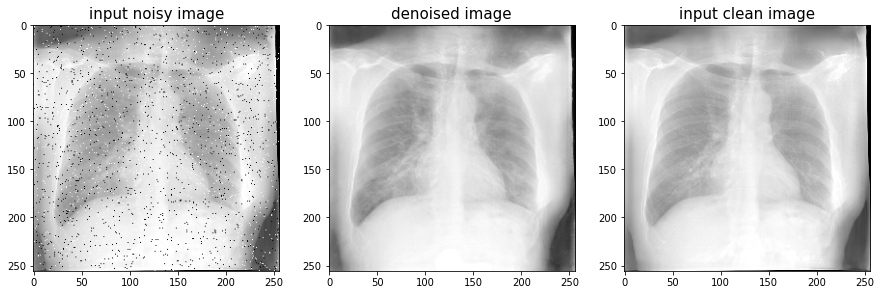

MSE of paired image 311.09
SSIM of paired image 83.11


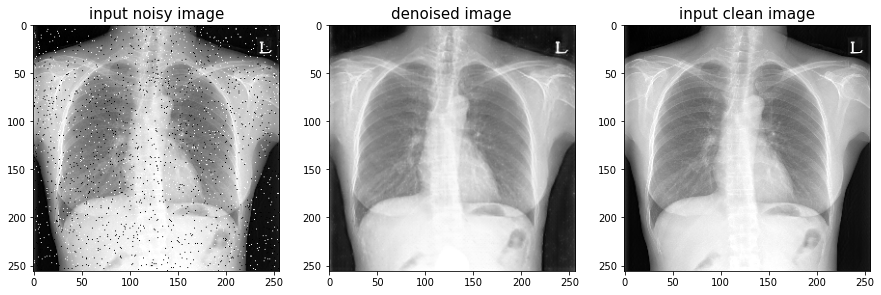

MSE of paired image 57.09
SSIM of paired image 89.68


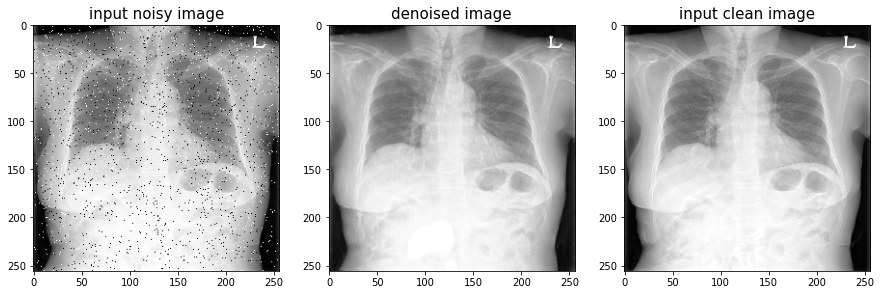

MSE of paired image 1586.99
SSIM of paired image 76.57


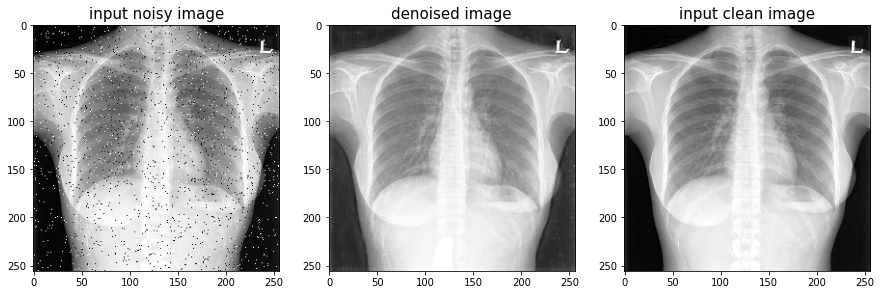

MSE of paired image 22.16
SSIM of paired image 91.6


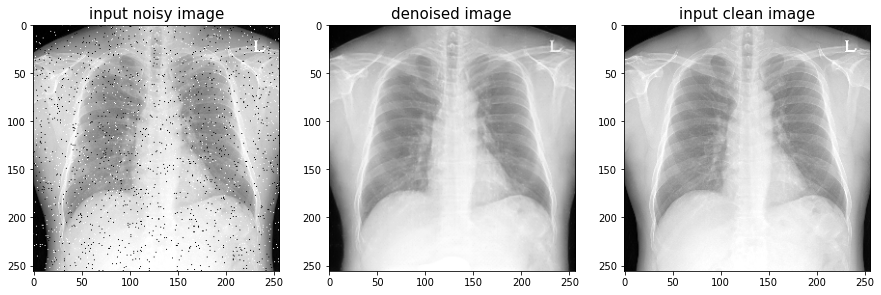

MSE of paired image 25.77
SSIM of paired image 90.69


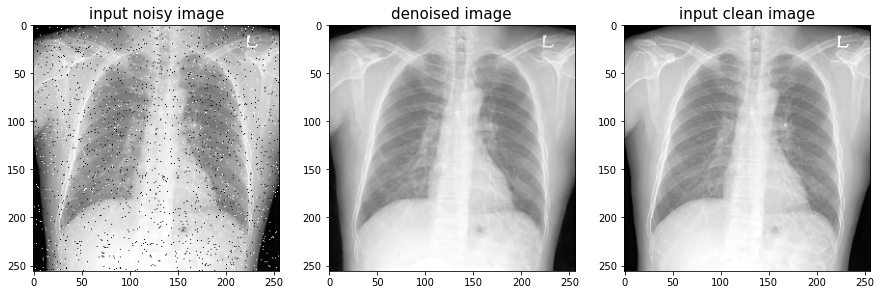

MSE of paired image 24.46
SSIM of paired image 90.99


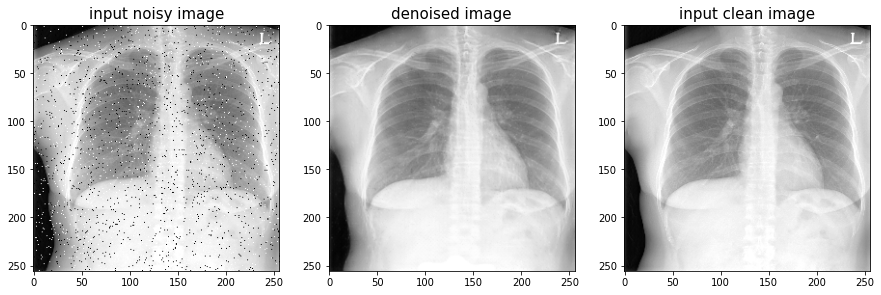

MSE of paired image 22.97
SSIM of paired image 91.23


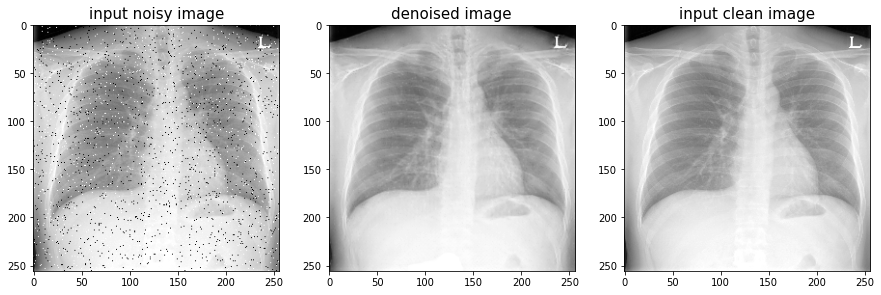

MSE of paired image 38.42
SSIM of paired image 90.95


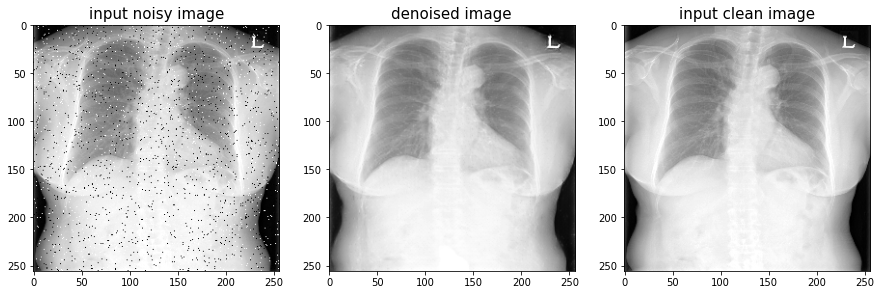

MSE of paired image 54.16
SSIM of paired image 88.95


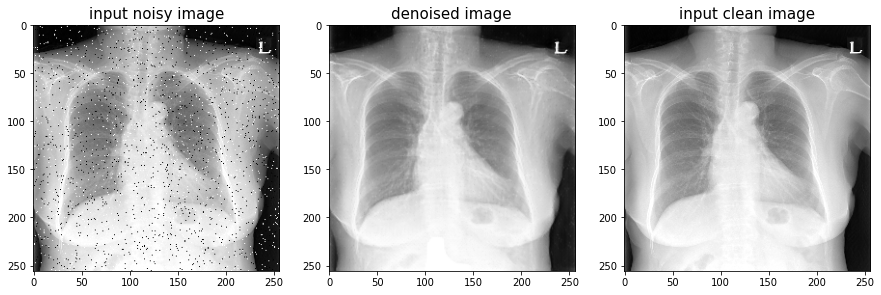

MSE of paired image 60.9
SSIM of paired image 90.68


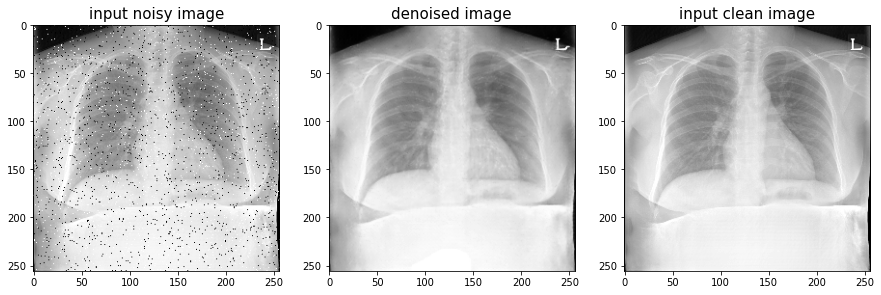

MSE of paired image 43.67
SSIM of paired image 89.46


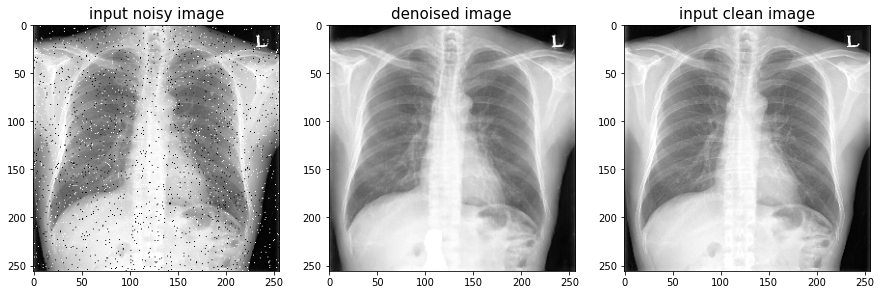

MSE of paired image 23.46
SSIM of paired image 91.14


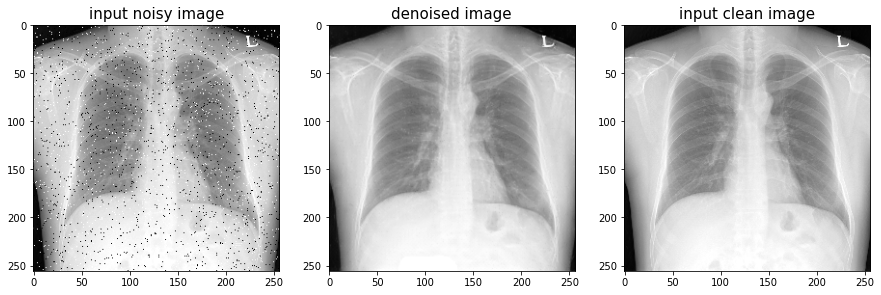

MSE of paired image 24.41
SSIM of paired image 92.2


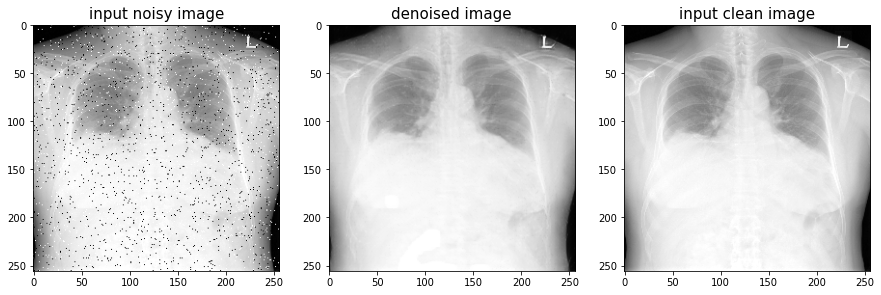

MSE of paired image 25.36
SSIM of paired image 91.76


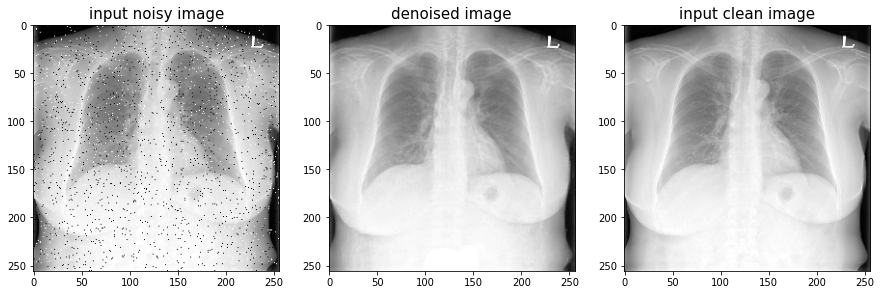

MSE of paired image 87.98
SSIM of paired image 88.44


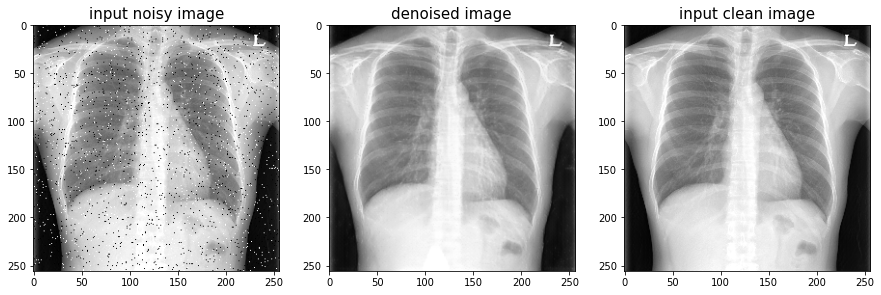

MSE of paired image 36.23
SSIM of paired image 89.99


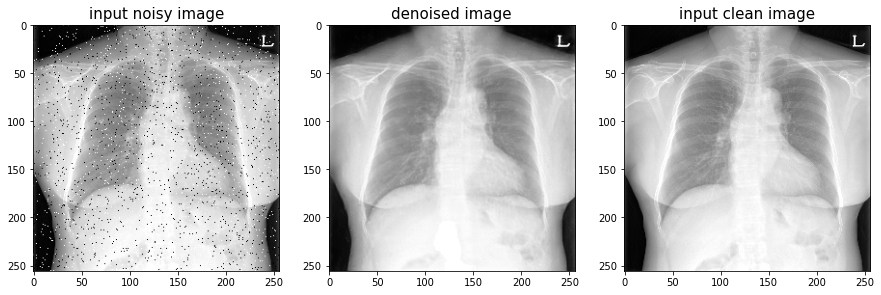

MSE of paired image 365.84
SSIM of paired image 83.21


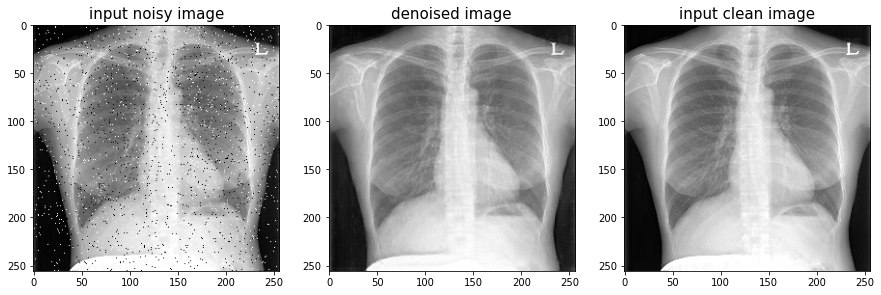

MSE of paired image 22.76
SSIM of paired image 91.45


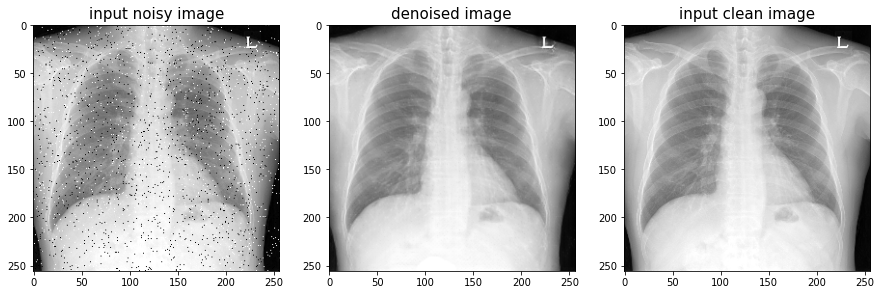

MSE of paired image 30.26
SSIM of paired image 90.65


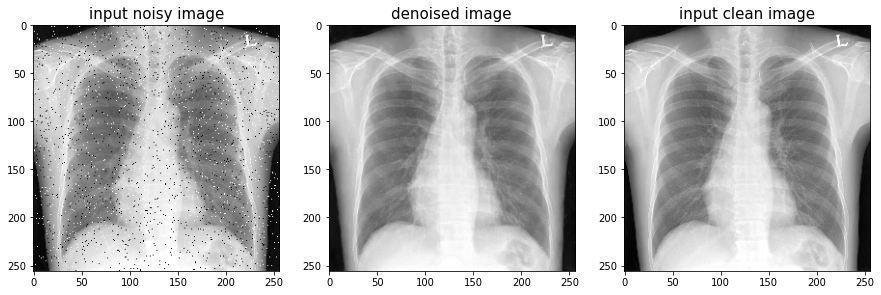

MSE of paired image 63.54
SSIM of paired image 88.87


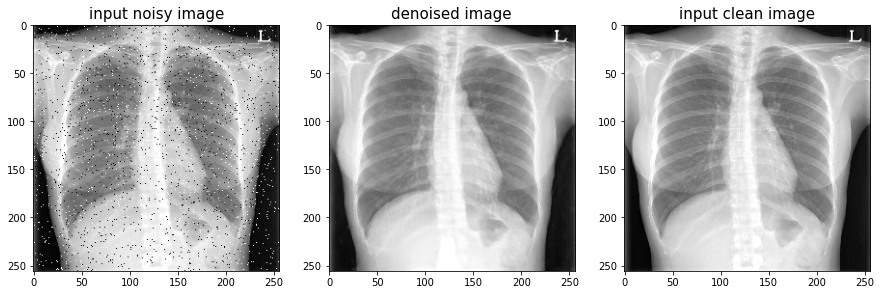

MSE of paired image 62.98
SSIM of paired image 89.36


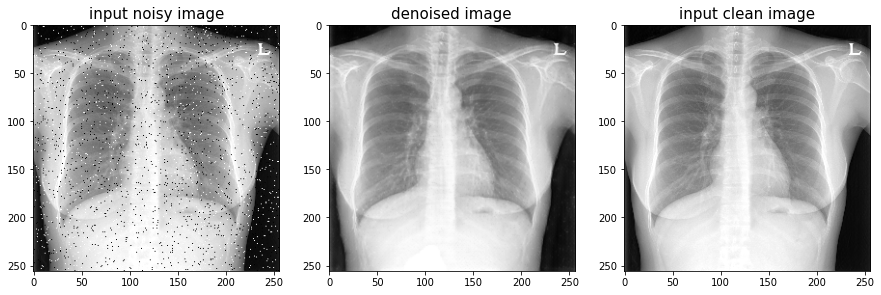

MSE of paired image 22.87
SSIM of paired image 91.6


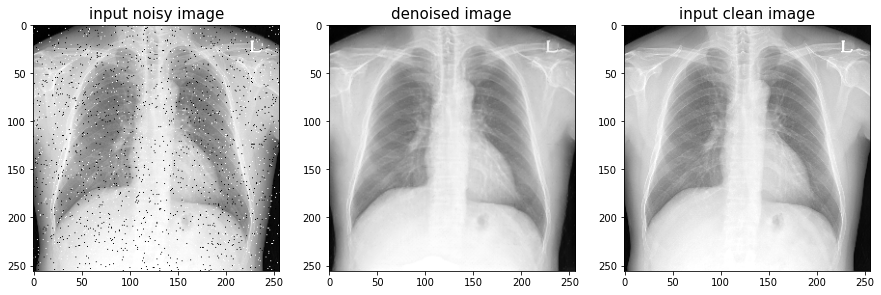

MSE of paired image 21.37
SSIM of paired image 91.55


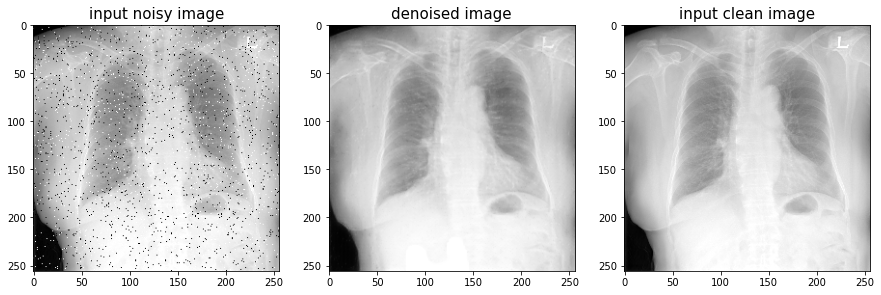

MSE of paired image 48.01
SSIM of paired image 88.96


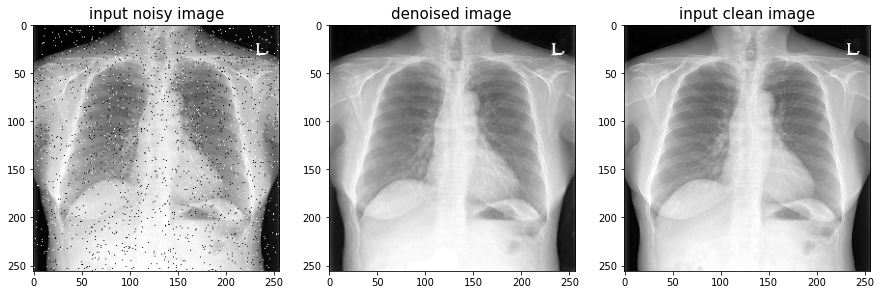

MSE of paired image 20.98
SSIM of paired image 91.6


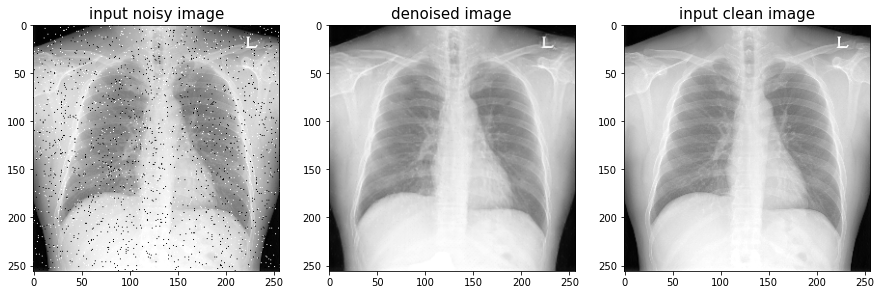

MSE of paired image 201.88
SSIM of paired image 86.37


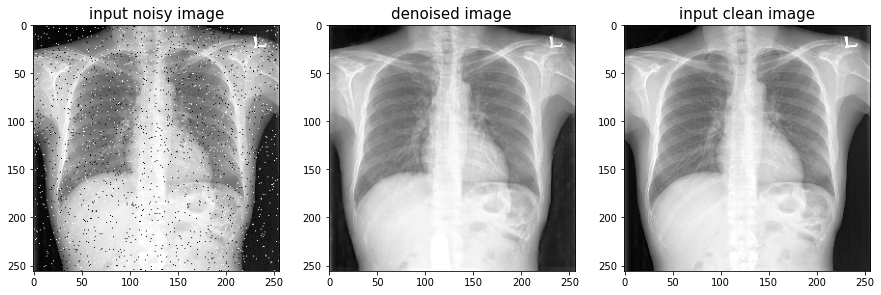

MSE of paired image 26.7
SSIM of paired image 90.36


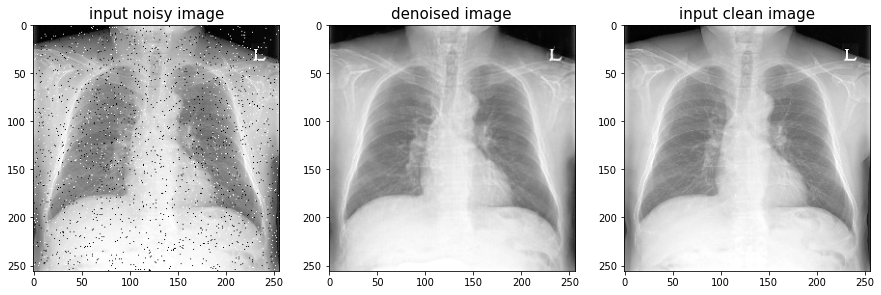

MSE of paired image 26.6
SSIM of paired image 91.07


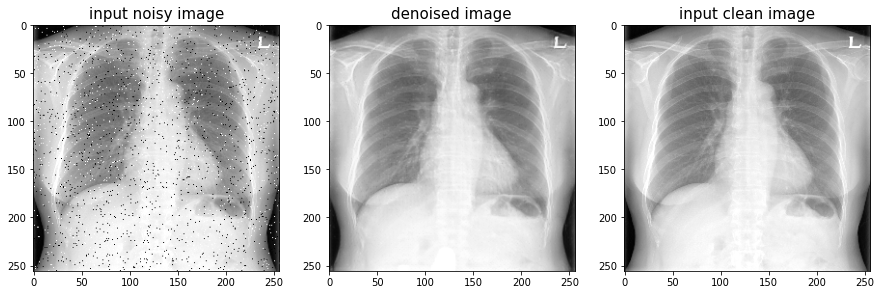

MSE of paired image 28.14
SSIM of paired image 90.18


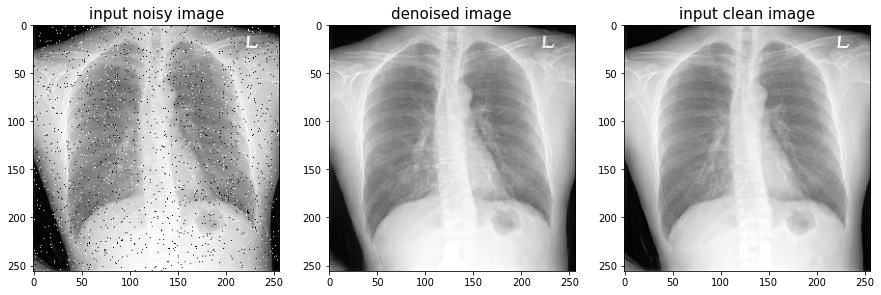

MSE of paired image 21.67
SSIM of paired image 91.91


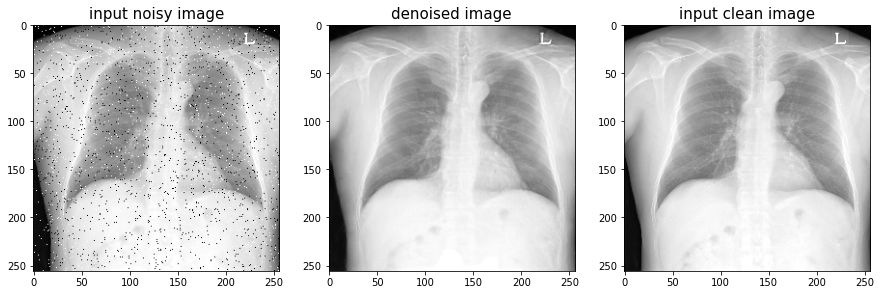

MSE of paired image 38.13
SSIM of paired image 89.34


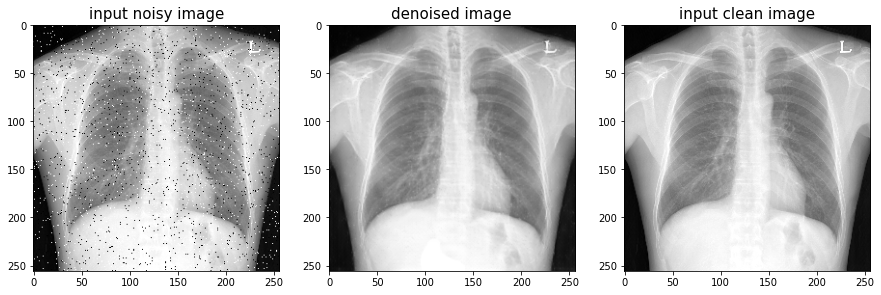

MSE of paired image 30.15
SSIM of paired image 90.33


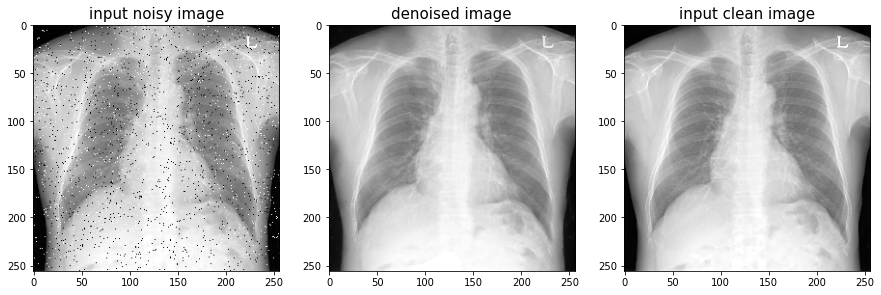

MSE of paired image 64.66
SSIM of paired image 89.51


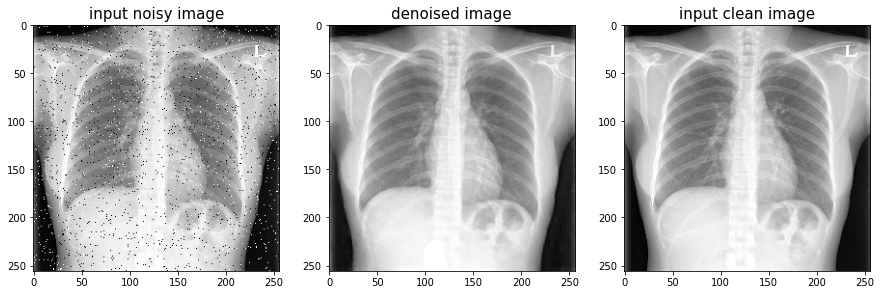

MSE of paired image 83.42
SSIM of paired image 87.38


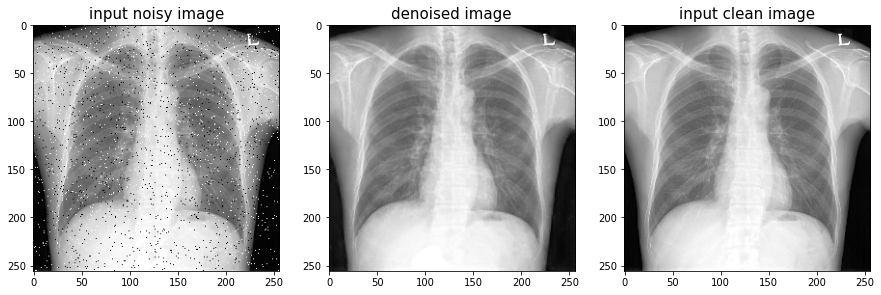

MSE of paired image 38.7
SSIM of paired image 89.53


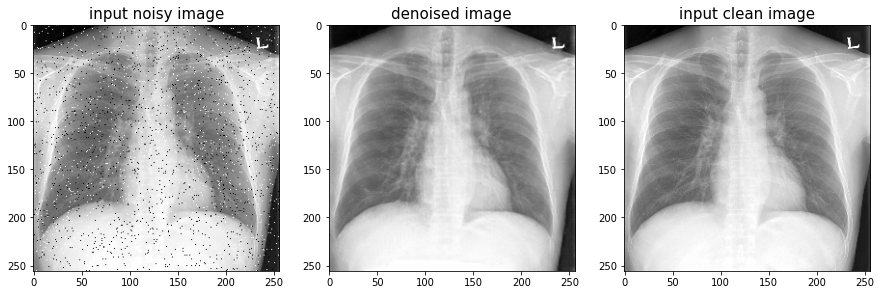

MSE of paired image 28.09
SSIM of paired image 91.04


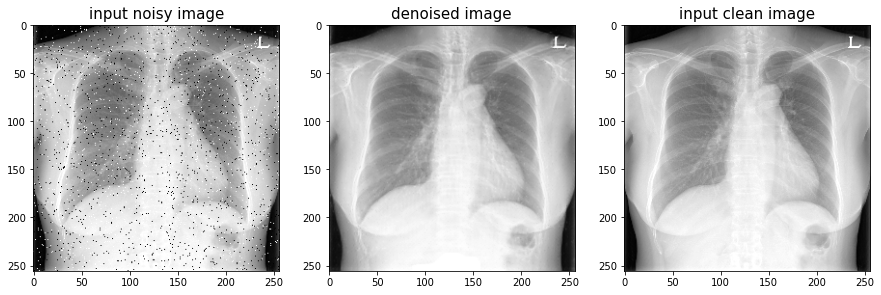

MSE of paired image 34.95
SSIM of paired image 90.34


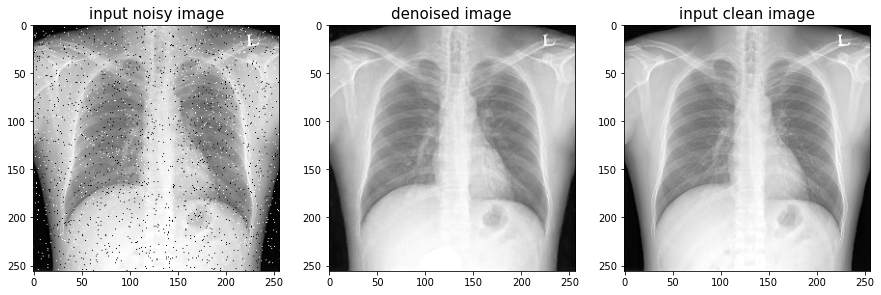

MSE of paired image 27.3
SSIM of paired image 91.22


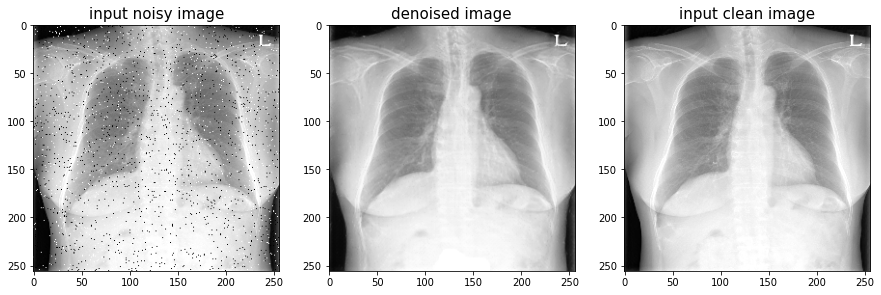

MSE of paired image 25.68
SSIM of paired image 91.11


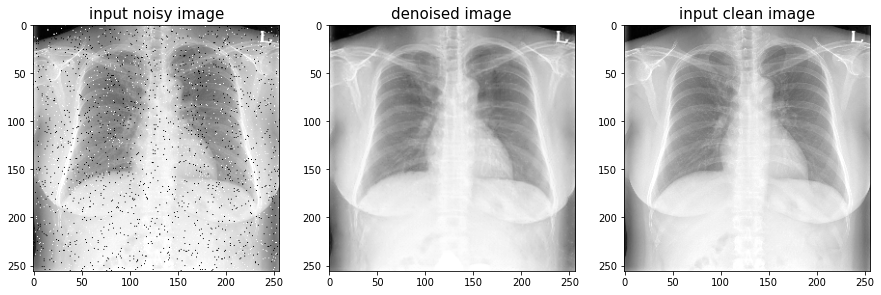

MSE of paired image 2780.17
SSIM of paired image 70.82


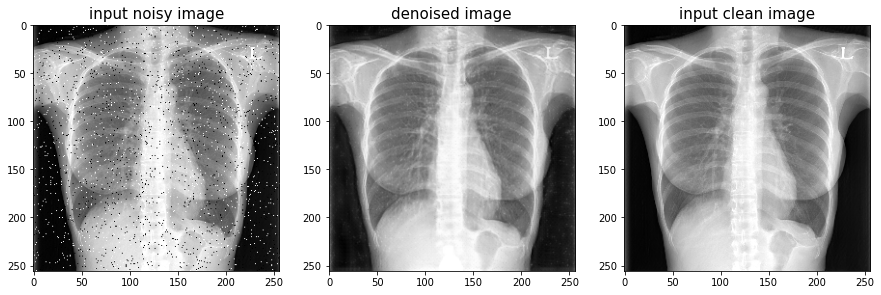

MSE of paired image 26.31
SSIM of paired image 91.63


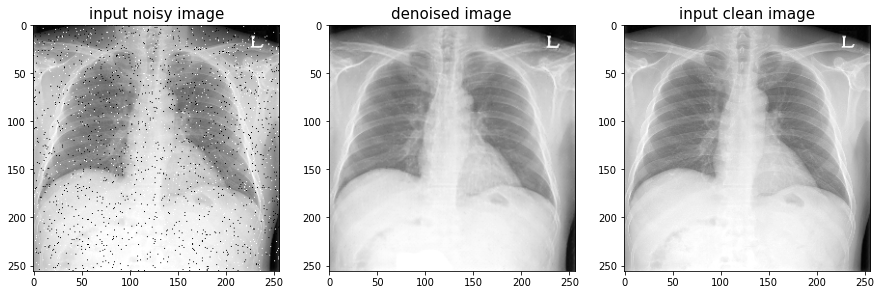

MSE of paired image 35.2
SSIM of paired image 90.27


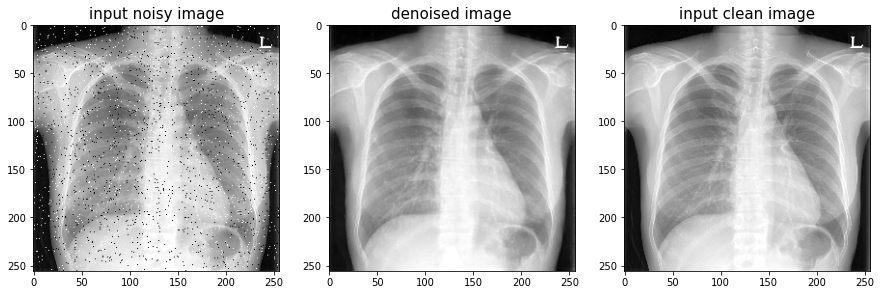

MSE of paired image 27.37
SSIM of paired image 91.11


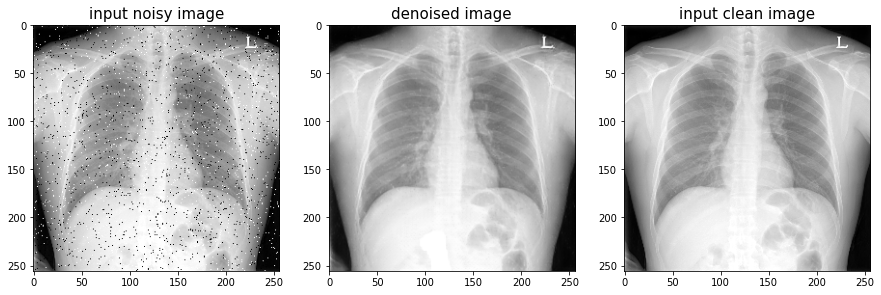

MSE of paired image 23.97
SSIM of paired image 91.43


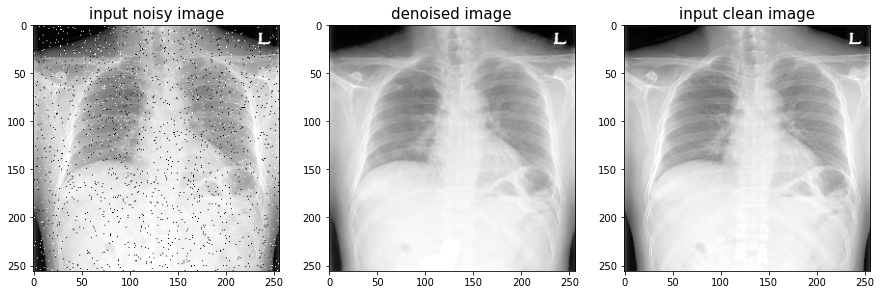

MSE of paired image 28.16
SSIM of paired image 90.42


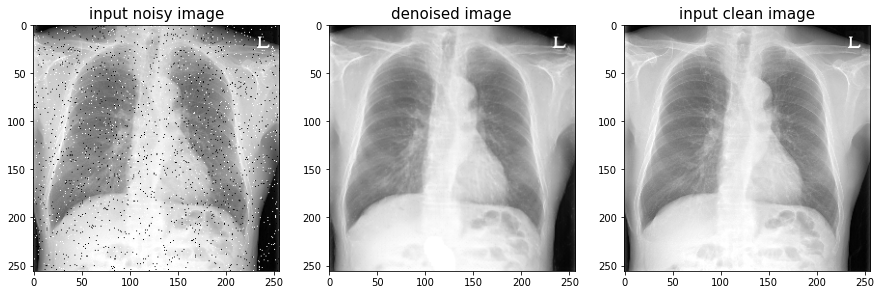

MSE of paired image 29.73
SSIM of paired image 91.02


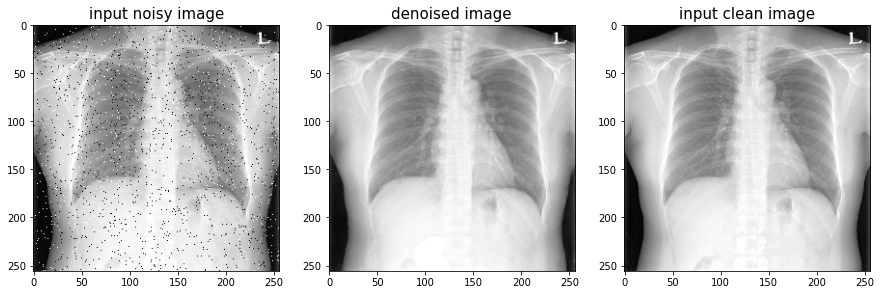

MSE of paired image 33.69
SSIM of paired image 90.4


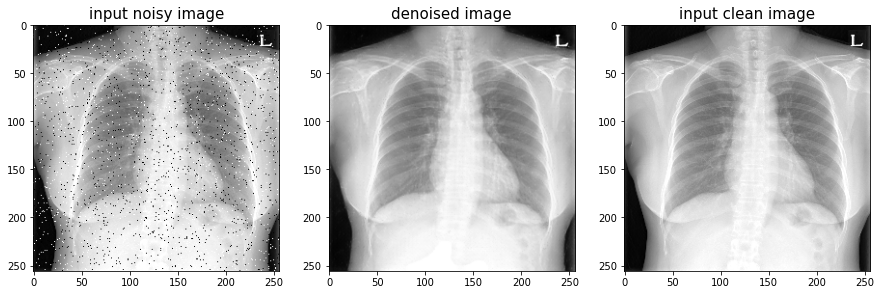

MSE of paired image 305.24
SSIM of paired image 82.63


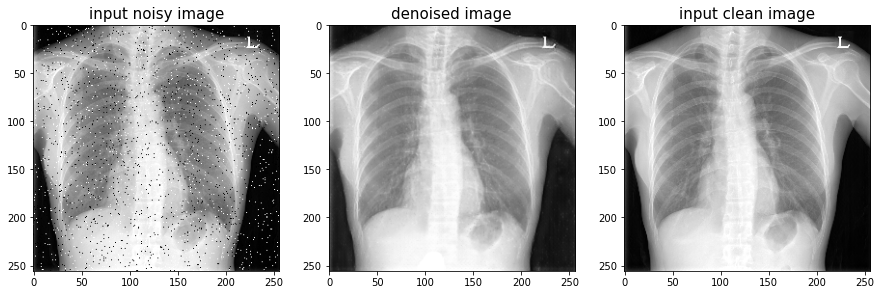

MSE of paired image 71.95
SSIM of paired image 87.82


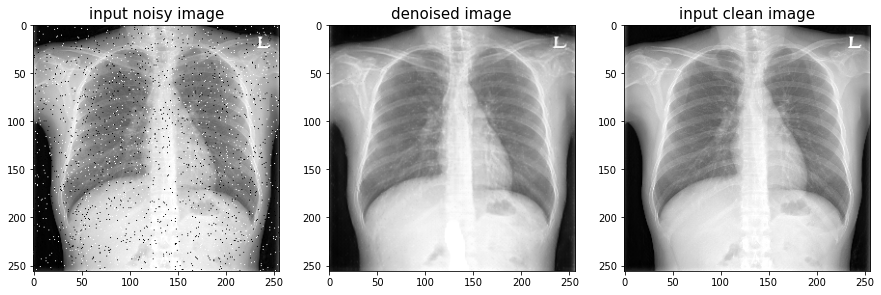

MSE of paired image 67.66
SSIM of paired image 88.49


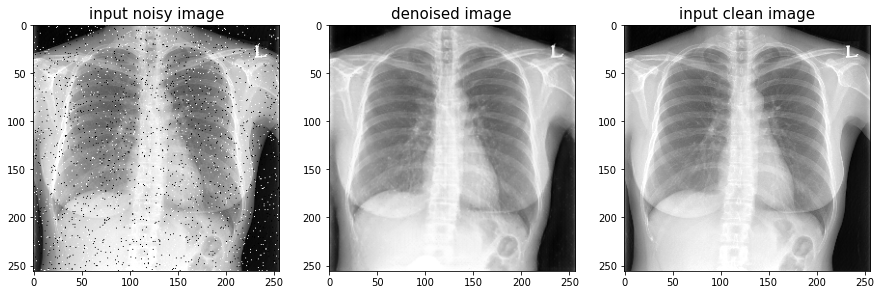

MSE of paired image 27.63
SSIM of paired image 90.97


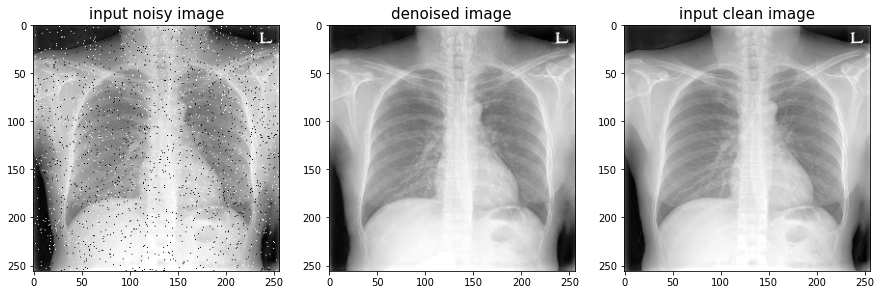

MSE of paired image 33.58
SSIM of paired image 90.75


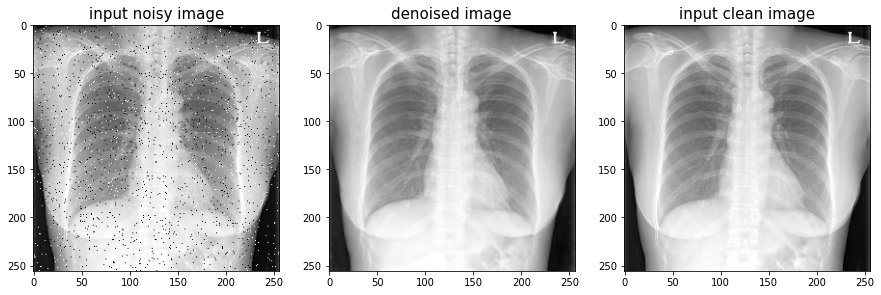

MSE of paired image 24.37
SSIM of paired image 91.63


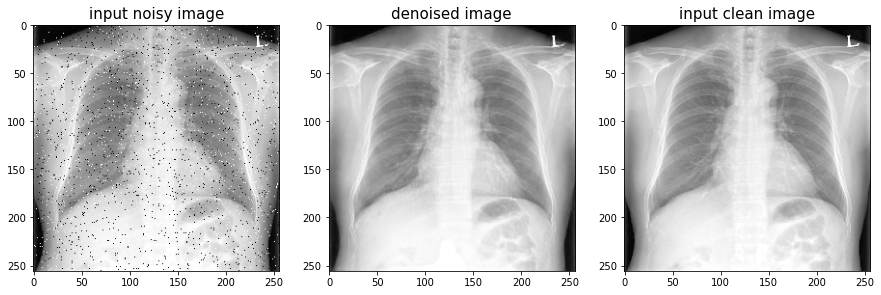

MSE of paired image 42.67
SSIM of paired image 89.87


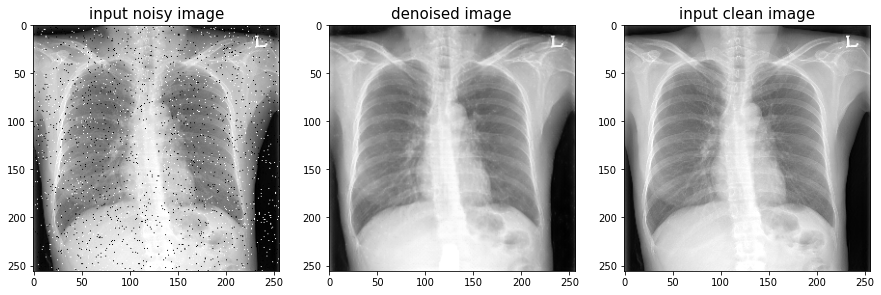

MSE of paired image 31.22
SSIM of paired image 90.66


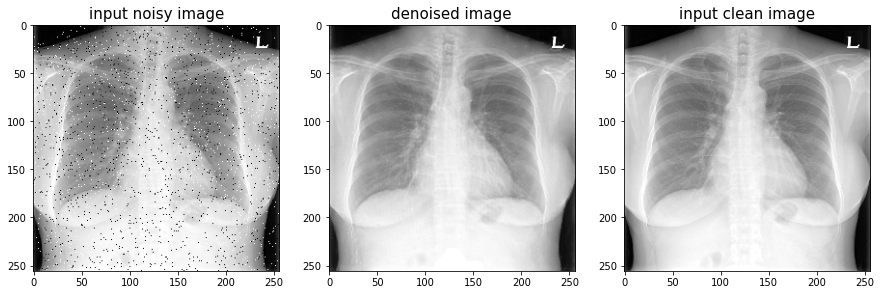

MSE of paired image 91.78
SSIM of paired image 87.23


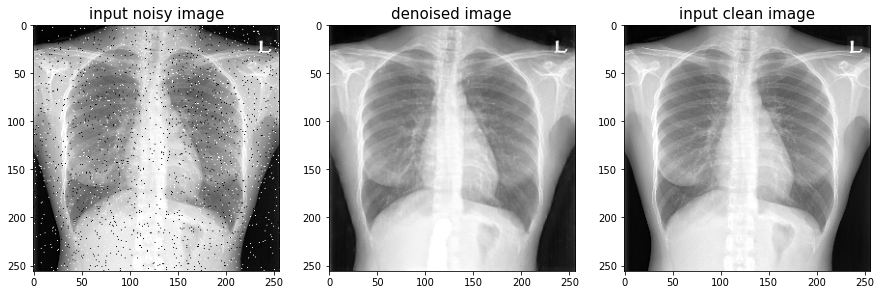

MSE of paired image 24.18
SSIM of paired image 91.44


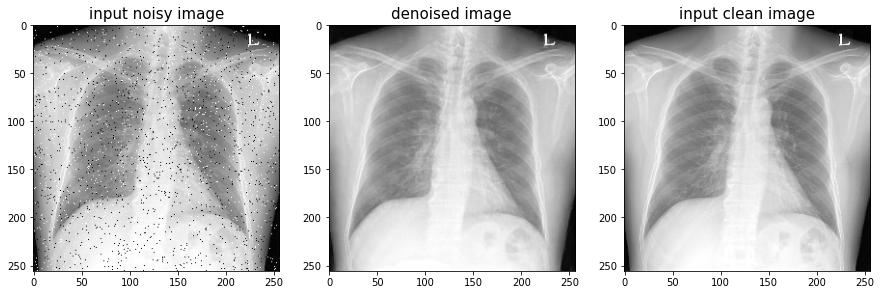

MSE of paired image 44.47
SSIM of paired image 90.1


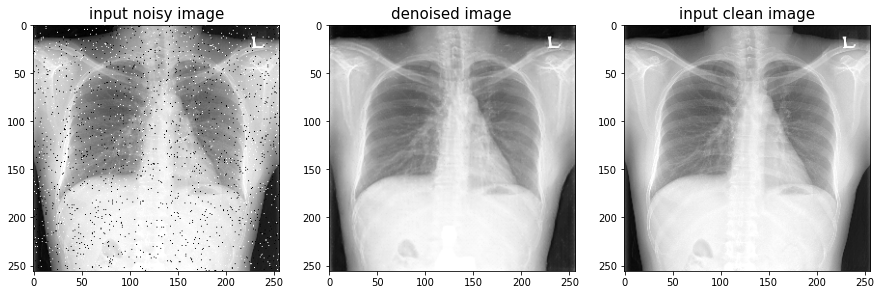

MSE of paired image 32.57
SSIM of paired image 90.6


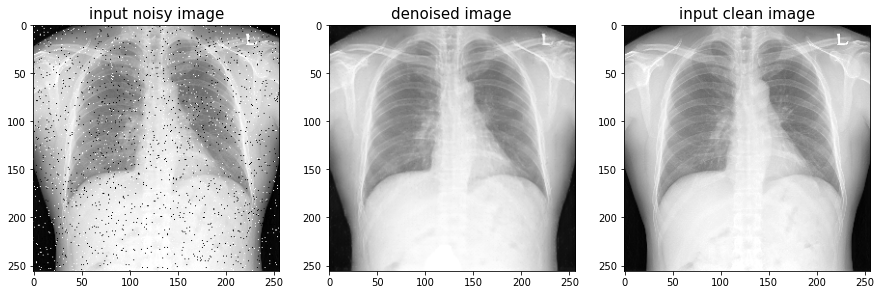

MSE of paired image 259.85
SSIM of paired image 85.5


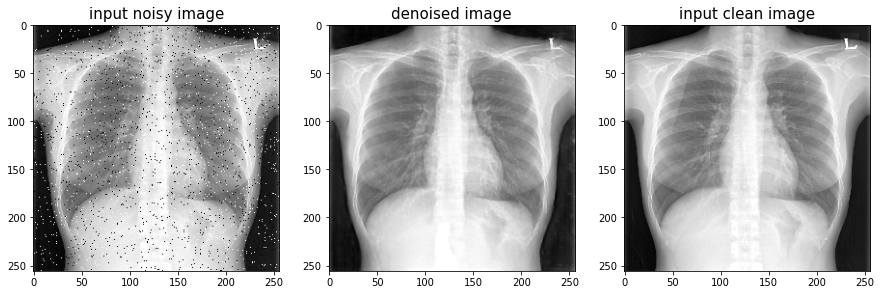

MSE of paired image 21.14
SSIM of paired image 91.4


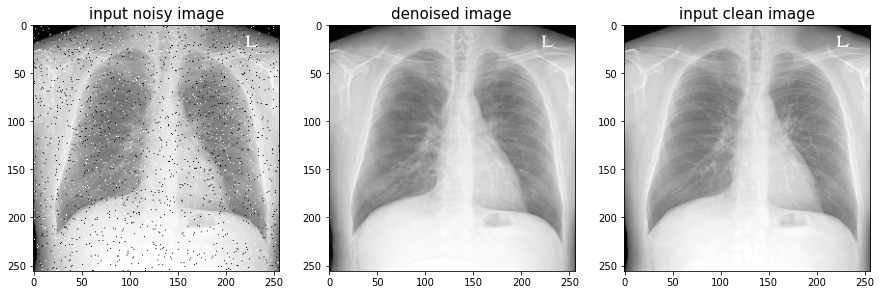

MSE of paired image 59.93
SSIM of paired image 87.82


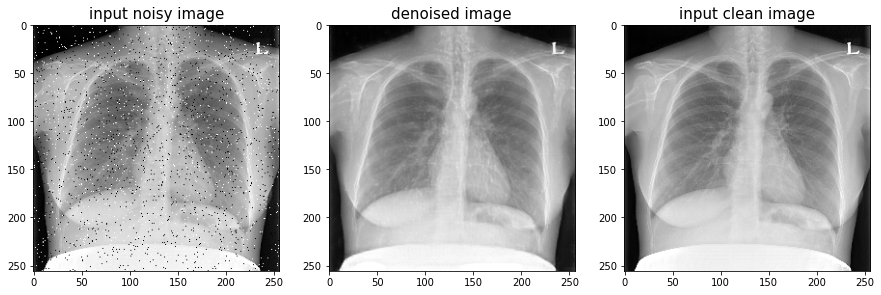

MSE of paired image 50.82
SSIM of paired image 88.74


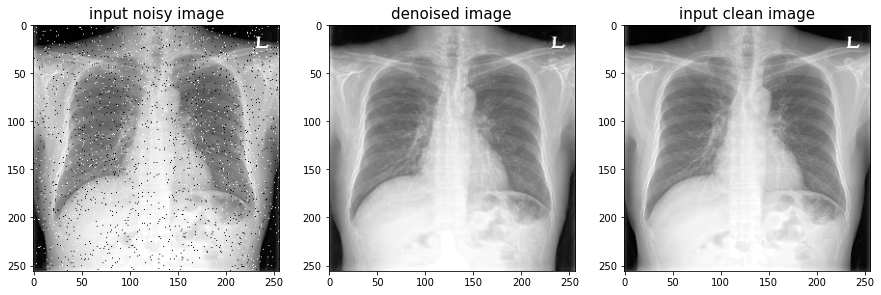

MSE of paired image 62.15
SSIM of paired image 88.58


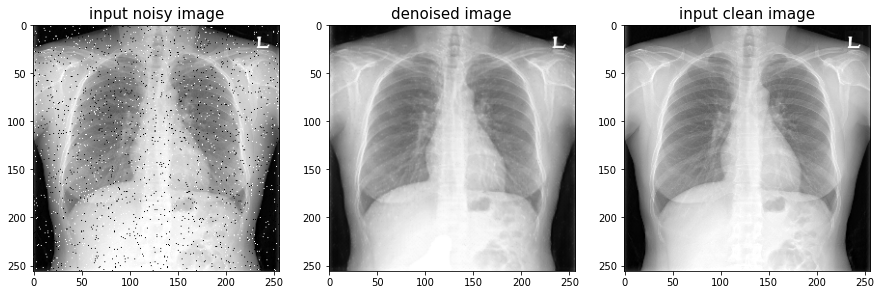

MSE of paired image 40.63
SSIM of paired image 90.05


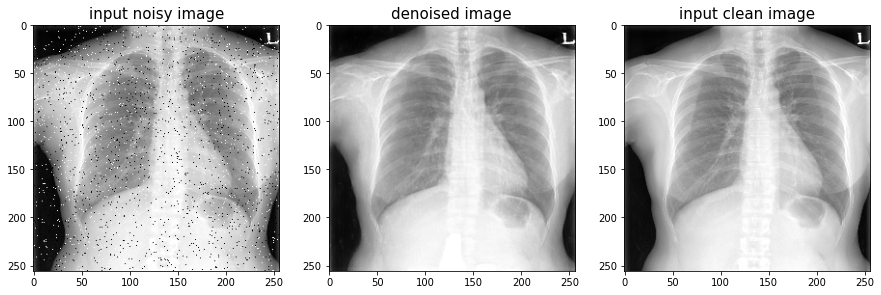

MSE of paired image 87.89
SSIM of paired image 87.75


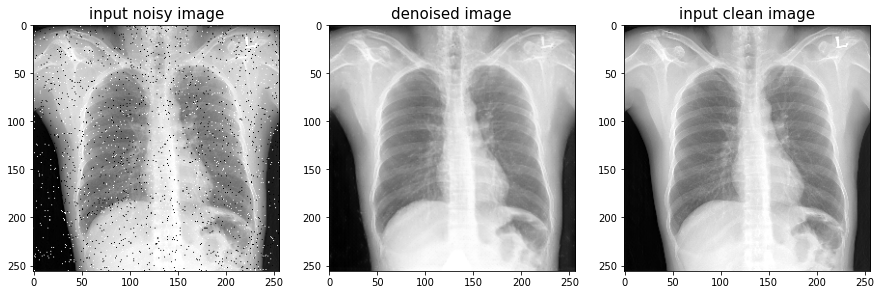

MSE of paired image 24.54
SSIM of paired image 91.3


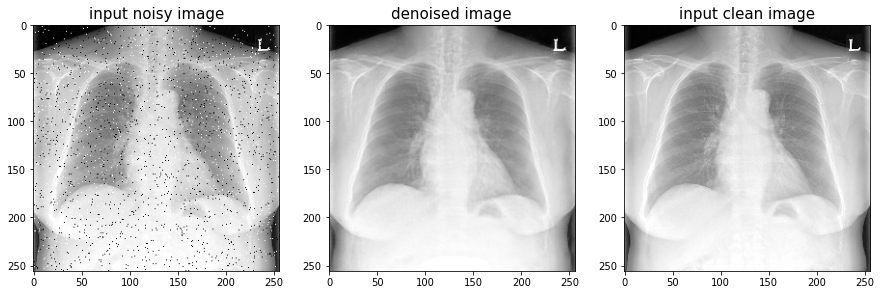

MSE of paired image 25.64
SSIM of paired image 90.15


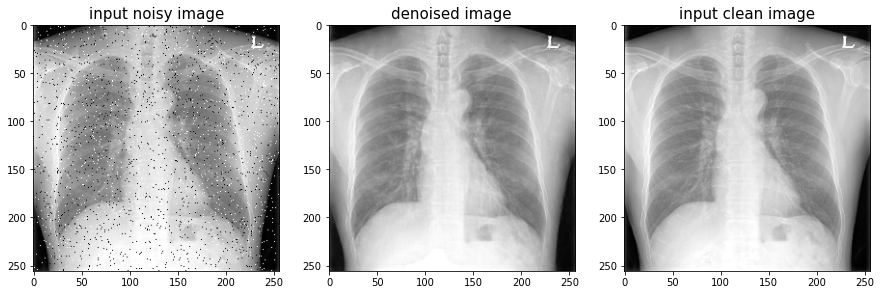

MSE of paired image 29.46
SSIM of paired image 90.54


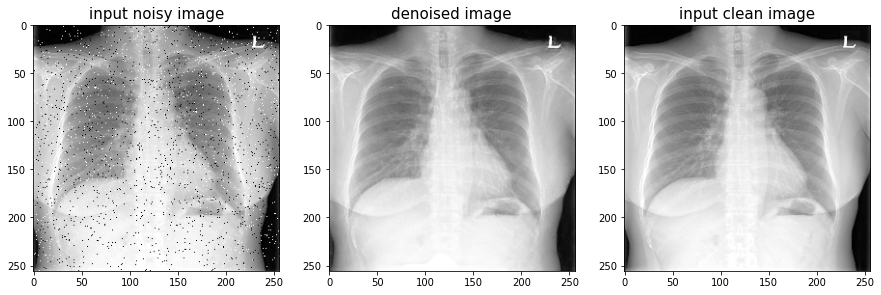

MSE of paired image 23.71
SSIM of paired image 91.17


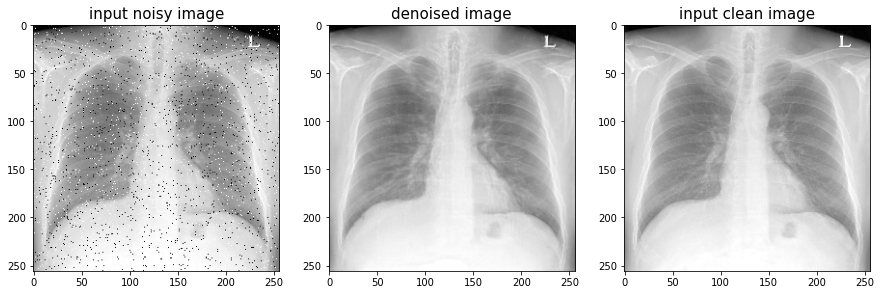

MSE of paired image 240.96
SSIM of paired image 83.61


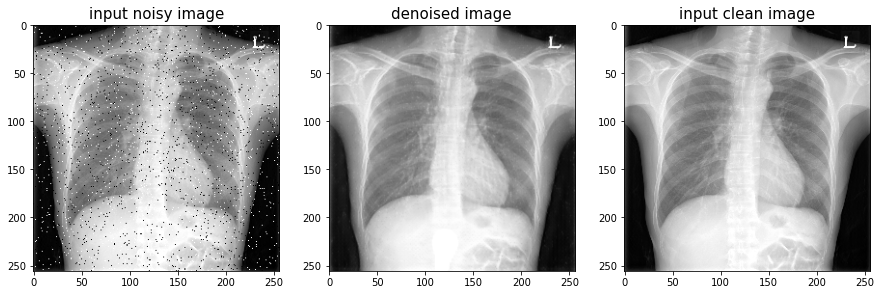

MSE of paired image 26.07
SSIM of paired image 90.03


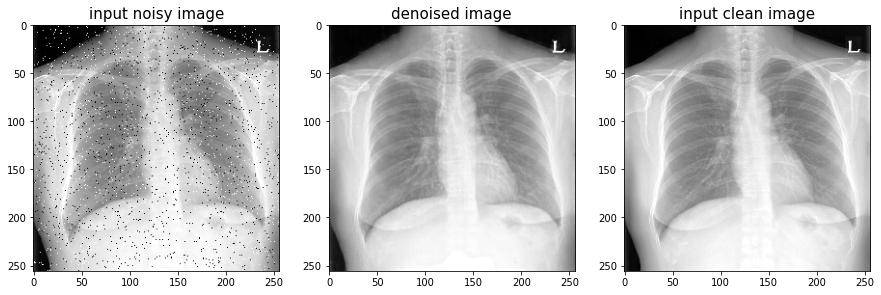

MSE of paired image 44.58
SSIM of paired image 89.26


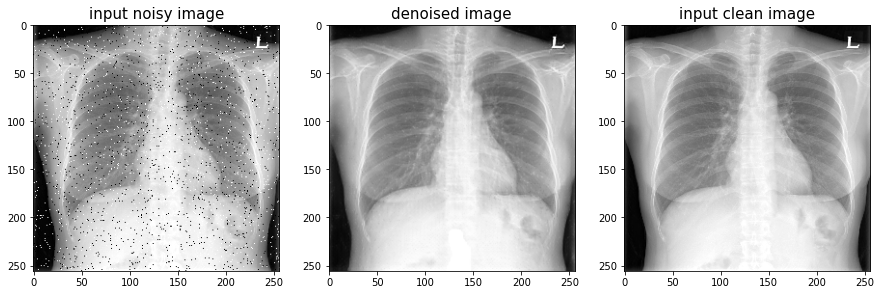

MSE of paired image 106.06
SSIM of paired image 87.22


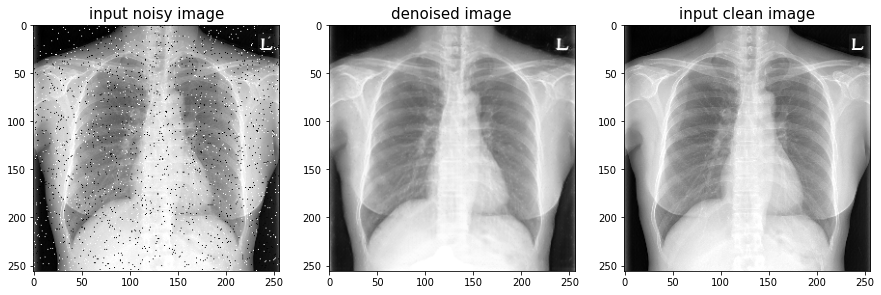

MSE of paired image 30.17
SSIM of paired image 90.19


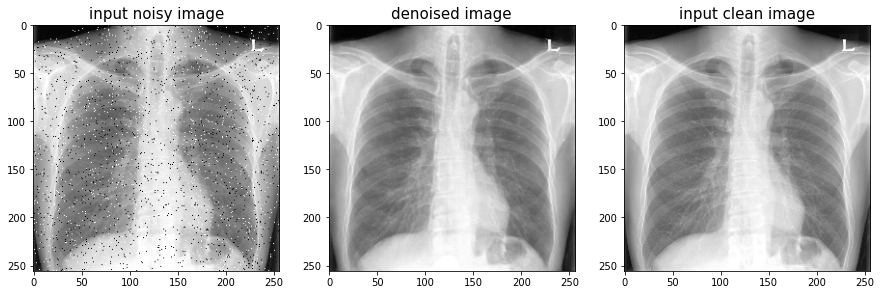

MSE of paired image 25.15
SSIM of paired image 91.23


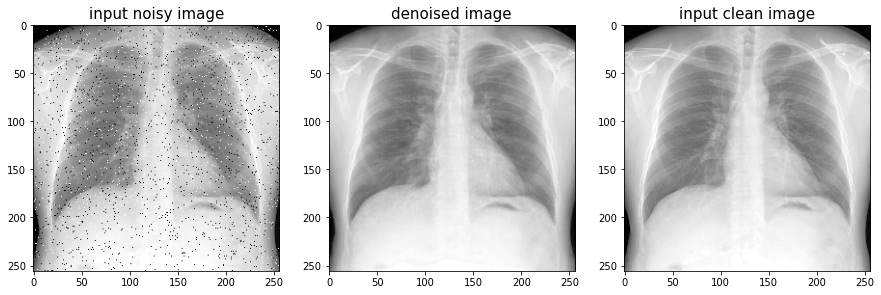

MSE of paired image 36.41
SSIM of paired image 90.4


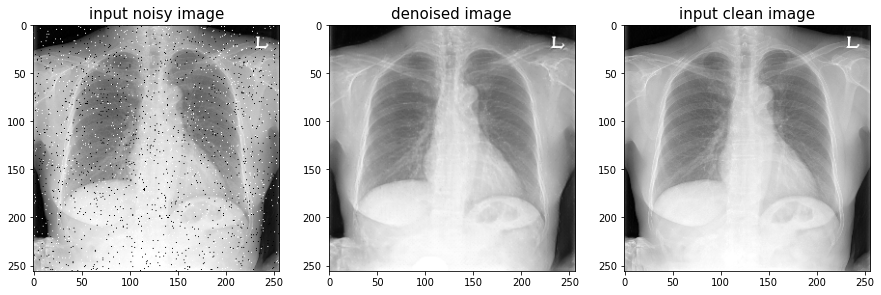

MSE of paired image 23.35
SSIM of paired image 91.25


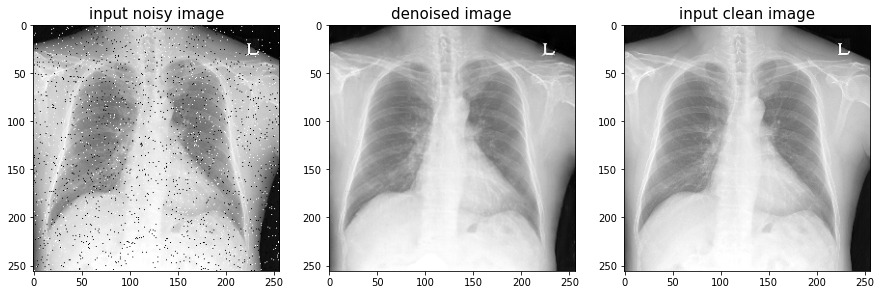

MSE of paired image 22.62
SSIM of paired image 91.18


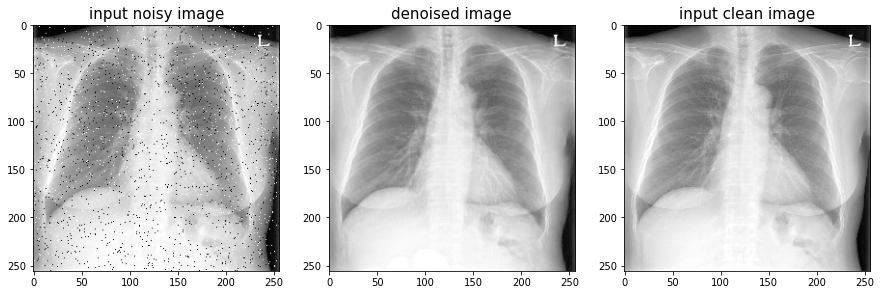

MSE of paired image 37.59
SSIM of paired image 89.78


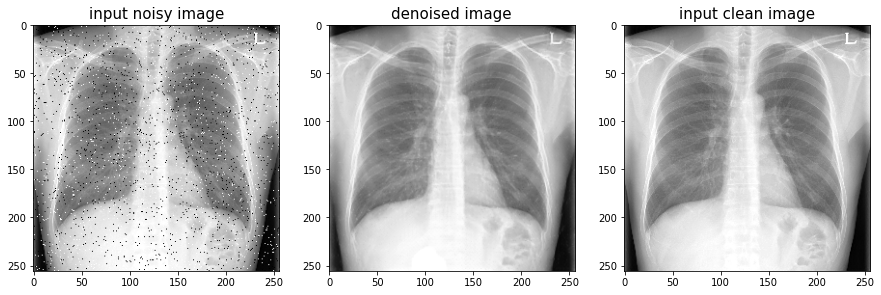

MSE of paired image 29.87
SSIM of paired image 90.57


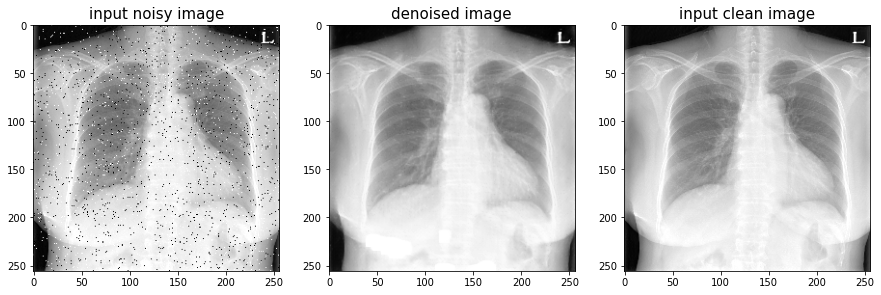

MSE of paired image 39.34
SSIM of paired image 89.84


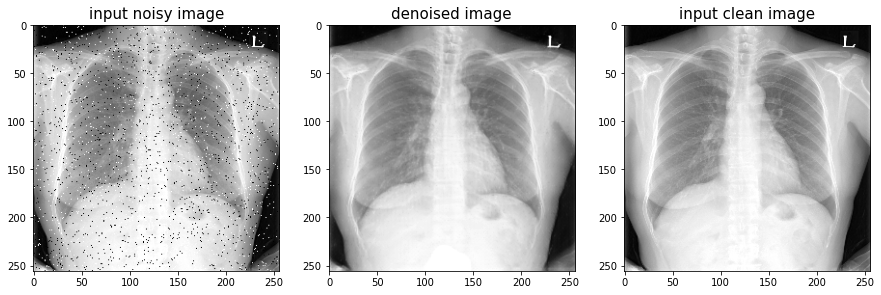

MSE of paired image 30.24
SSIM of paired image 91.12


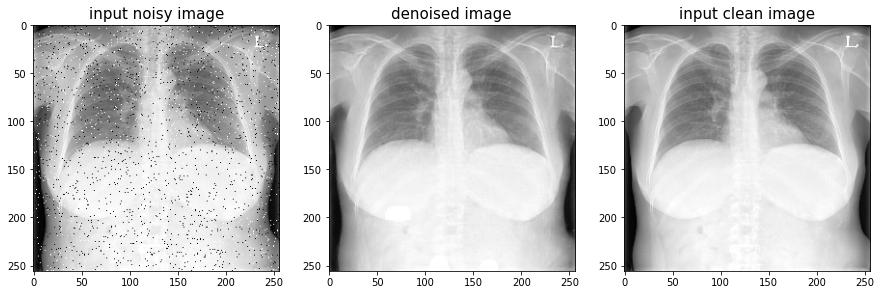

MSE of paired image 24.61
SSIM of paired image 91.13


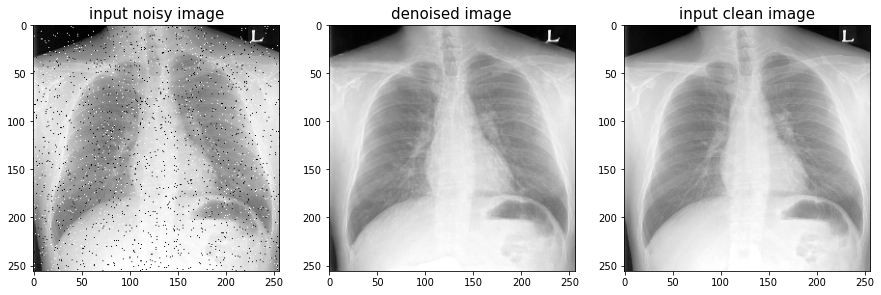

MSE of paired image 33.49
SSIM of paired image 90.62


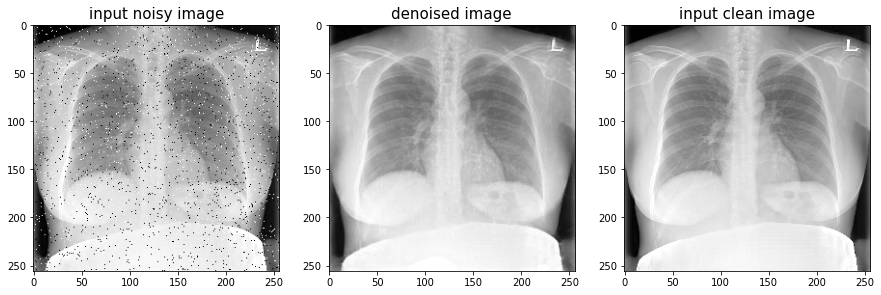

MSE of paired image 58.83
SSIM of paired image 88.63


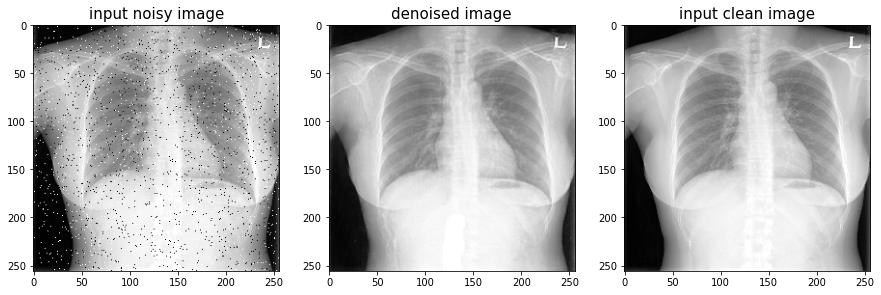

In [ ]:
#테스트 이미지에 대해 MSE와 SSIM구하기
import glob
import numpy as np

real_images=glob.glob(os.path.join('results/promedius_cxr_2000_for_cyclegan/test_latest/images', '*_real.png'))

mse_arr=[]
ssim_arr=[]
for tmp in range(len(real_images)):
    
    img_real=cv2.imread(real_images[tmp], 0)
    img_syn=cv2.imread(real_images[tmp].replace('real', 'fake'), 0)
    
    img_real_clean_pair=cv2.imread(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan/testB', real_images[tmp].replace('_real', '').split('/')[-1]), 0)
    
    mse_v, ssim_v = compare_images(img_real_clean_pair, img_syn)
    
    print('MSE of paired image', round(mse_v, 2))
    print('SSIM of paired image', round((ssim_v*100.), 2))
    
    mse_arr.append(mse_v)
    ssim_arr.append(ssim_v)
    
    plt.figure(figsize=(15,10))
    plt.subplot(131)
    plt.title('input noisy image', fontsize=15)
    plt.imshow(img_real, cmap='gray')
    plt.subplot(132)
    plt.title('denoised image', fontsize=15)
    plt.imshow(img_syn, cmap='gray')
    plt.subplot(133)
    plt.title('input clean image', fontsize=15)
    plt.imshow(img_real_clean_pair, cmap='gray')
    plt.show()

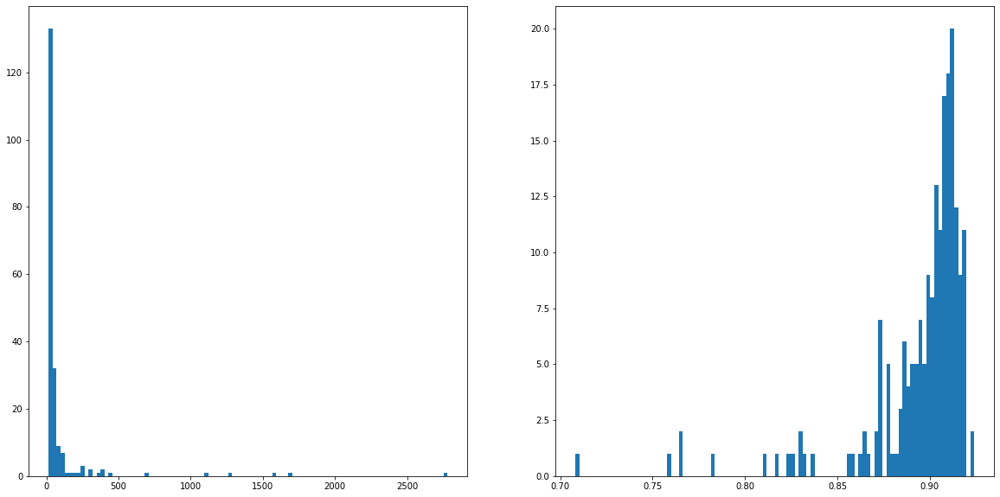

In [ ]:
이미지 비교 metric MSE와 SSIM히스토그램 그려보기
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.hist(mse_arr, bins=100)
plt.subplot(122)
plt.hist(ssim_arr, bins=100)     
plt.show()

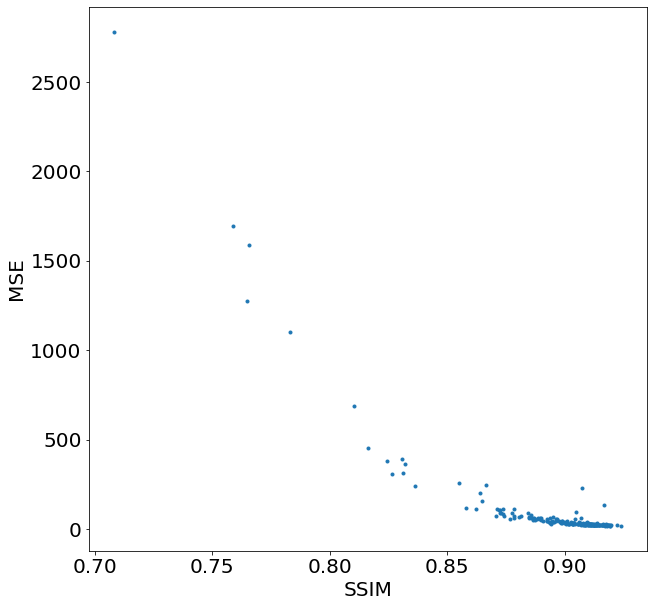

In [ ]:
#이미지 비교 metric MSE와 SSIM상관관계 그려보기(MSE는 로그스케일로 그려보기)
plt.figure(figsize=(10,10))
plt.plot(ssim_arr, mse_arr, '.')
plt.xlabel('SSIM', fontsize=20)
plt.ylabel('MSE', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.show()

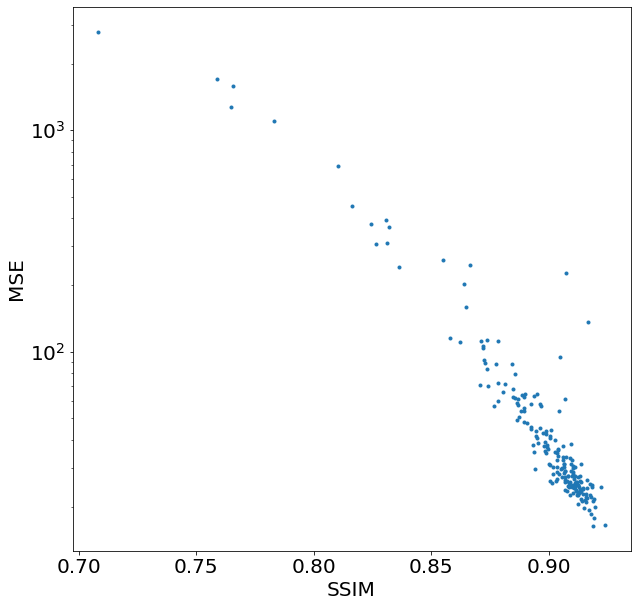

In [ ]:
#이미지 비교 metric MSE와 SSIM상관관계 그려보기(MSE는 로그스케일로 그려보기)
plt.figure(figsize=(10,10))
plt.plot(ssim_arr, mse_arr, '.')
plt.xlabel('SSIM', fontsize=20)
plt.ylabel('MSE', fontsize=20)
plt.tick_params(axis='both', which='major', labelsize=20)
plt.yscale("log")
plt.show()

In [ ]:
#MSE가 1000보다 큰 것에 대한 이미지 리스트 찾기
mse_arr_np=np.asarray(mse_arr)
mse_over_1000_list=list(np.where(mse_arr_np > 1000))[0]
print(mse_over_1000_list)

[ 56  64  77 116 153]


MSE of paired image 1276.71
SSIM of paired image 76.47


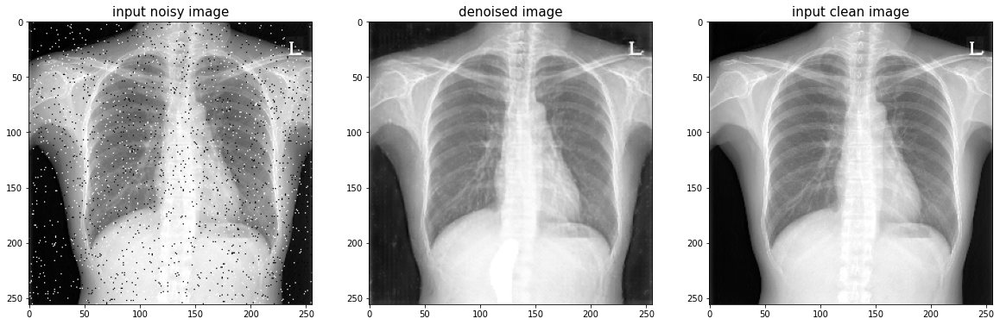

MSE of paired image 1100.05
SSIM of paired image 78.31


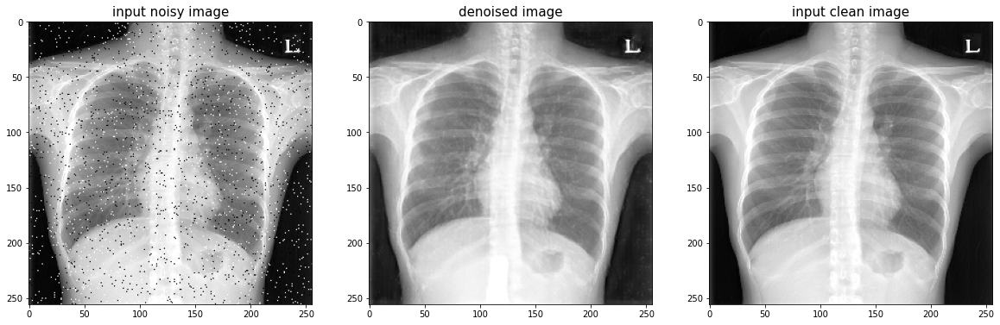

MSE of paired image 1695.45
SSIM of paired image 75.88


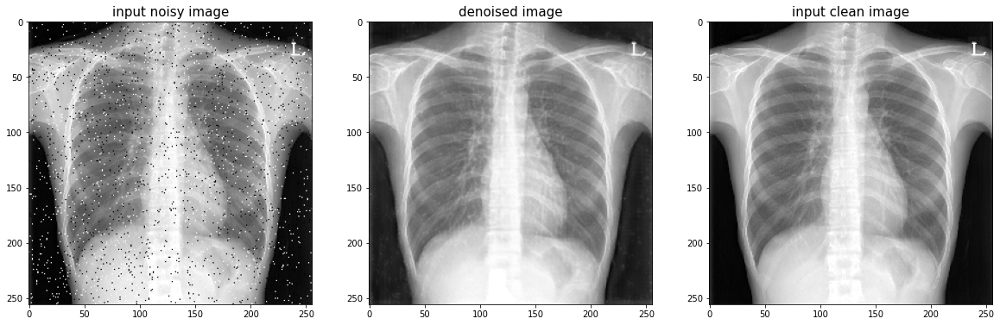

MSE of paired image 1586.99
SSIM of paired image 76.57


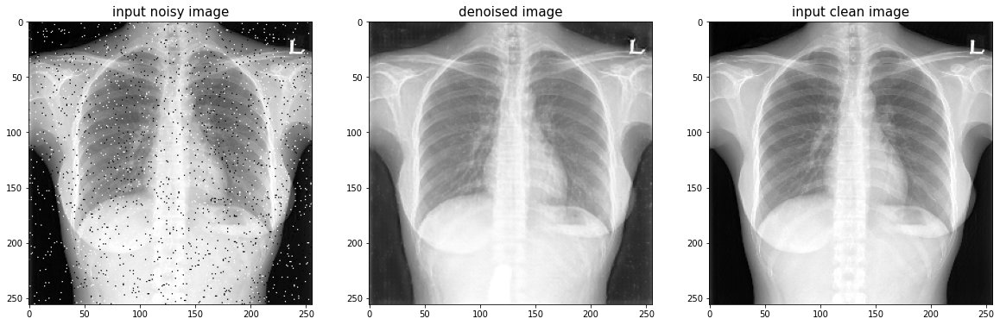

MSE of paired image 2780.17
SSIM of paired image 70.82


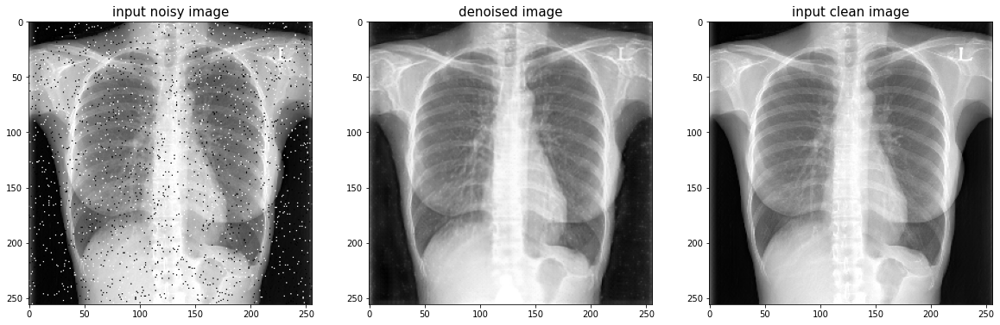

In [ ]:
#MSE가 1000보다 큰 것에 대한 이미지 그려서, 왜 큰 차이가 나는지 visual examination해보기
for tmp in range(len(mse_over_1000_list)):
    
    img_real=cv2.imread(real_images[mse_over_1000_list[tmp]], 0)
    img_syn=cv2.imread(real_images[mse_over_1000_list[tmp]].replace('real', 'fake'), 0)
    
    img_real_clean_pair=cv2.imread(os.path.join('handson_data_GAN/promedius_cxr_2000_for_cyclegan/testB', real_images[mse_over_1000_list[tmp]].replace('_real', '').split('/')[-1]), 0)
    
    mse_v, ssim_v = compare_images(img_real_clean_pair, img_syn)
    
    print('MSE of paired image', round(mse_v, 2))
    print('SSIM of paired image', round((ssim_v*100.), 2))
    
    plt.figure(figsize=(20,10))
    plt.subplot(131)
    plt.title('input noisy image', fontsize=15)
    plt.imshow(img_real, cmap='gray')
    plt.subplot(132)
    plt.title('denoised image', fontsize=15)
    plt.imshow(img_syn, cmap='gray')
    plt.subplot(133)
    plt.title('input clean image', fontsize=15)
    plt.imshow(img_real_clean_pair, cmap='gray')
    plt.show()